In [4]:
"""
CLIP (Contrastive Language-Image Pre-Training) Implementation
===========================================================

This notebook implements a custom CLIP model for image-text retrieval using the Flickr8k dataset.
CLIP learns to associate images with their textual descriptions through contrastive learning.

Key Components:
- Custom CLIP architecture with image and text encoders
- Contrastive loss implementation
- FAISS-based efficient similarity search
- Model evaluation and testing
"""

'\nCLIP (Contrastive Language-Image Pre-Training) Implementation\n===========================================================\n\nThis notebook implements a custom CLIP model for image-text retrieval using the Flickr8k dataset.\nCLIP learns to associate images with their textual descriptions through contrastive learning.\n\nKey Components:\n- Custom CLIP architecture with image and text encoders\n- Contrastive loss implementation\n- FAISS-based efficient similarity search\n- Model evaluation and testing\n'

In [5]:
#@title Installation and Setup
!pip install timm
!pip install transformers
!pip install albumentations
!pip install faiss-cpu
!pip install datasets
!pip install git+https://github.com/openai/CLIP.git

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 31.4/31.4 MB 20.6 MB/s eta 0:00:00
  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-4l0wcm7d
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-4l0wcm7d
  Resolved https://github.com/openai/CLIP.git to commit dcba3cb2e2827b402d2701e7e1c7d9fed8a20ef1
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 3.1 MB/s eta 0:00:00
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1369490 sha256=9ba86671f389be9177d46b12bd04a63ecc0d1de50c70e929d2bc1c45daf77ead
  Stored in directory: /tmp/pip-ephem-wheel-cache-hi2ax6qe/wheels/35/3e/df/3d24cbfb3b6a06f17a2bfd7d1138900d4365d9028aa8f6e92f
Successfully built clip


In [6]:
import os
import cv2
import gc
import numpy as np
import pandas as pd
import itertools
from tqdm.autonotebook import tqdm
import albumentations as A
import matplotlib.pyplot as plt
import clip
import torch
from torch import nn
import torch.nn.functional as F
import timm
from transformers import DistilBertModel, DistilBertConfig, DistilBertTokenizer
import faiss
from datasets import load_dataset
from datasets import load_dataset, DatasetDict, Dataset
import torch.optim as optim

/tmp/ipython-input-3861057008.py:7: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm


In [7]:
#@title Dataset Download and Preparation
"""
Download Flickr8k Dataset from Kaggle
====================================

Flickr8k contains 8,000 images, each paired with 5 different captions.
This creates a rich dataset for training image-text association models.
"""
!pip install kaggle --upgrade
os.environ['KAGGLE_USERNAME'] = "XXXXX"
os.environ['KAGGLE_KEY'] = "XXXXXXXXXXXXXX"

In [8]:
### For Flickr 8k
!kaggle datasets download -d adityajn105/flickr8k
!unzip flickr8k.zip
dataset = "8k"

Streaming output truncated to the last 5000 lines.
  inflating: Images/2844963839_ff09cdb81f.jpg  
  inflating: Images/2845246160_d0d1bbd6f0.jpg  
  inflating: Images/2845691057_d4ab89d889.jpg  
  inflating: Images/2845845721_d0bc113ff7.jpg  
  inflating: Images/2846037553_1a1de50709.jpg  
  inflating: Images/2846785268_904c5fcf9f.jpg  
  inflating: Images/2846843520_b0e6211478.jpg  
  inflating: Images/2847514745_9a35493023.jpg  
  inflating: Images/2847615962_c330bded6e.jpg  
  inflating: Images/2847859796_4d9cb0d31f.jpg  
  inflating: Images/2848266893_9693c66275.jpg  
  inflating: Images/2848571082_26454cb981.jpg  
  inflating: Images/2848895544_6d06210e9d.jpg  
  inflating: Images/2848977044_446a31d86e.jpg  
  inflating: Images/2849194983_2968c72832.jpg  
  inflating: Images/2850719435_221f15e951.jpg  
  inflating: Images/2851198725_37b6027625.jpg  
  inflating: Images/2851304910_b5721199bc.jpg  
  inflating: Images/2851931813_eaf8ed7be3.jpg  
  inflating: Images/2852982055_8112d0

In [9]:
if dataset == "8k":
  df = pd.read_csv("captions.txt")
  df['id'] = [id_ for id_ in range(df.shape[0] // 5) for _ in range(5)]
  df.to_csv("captions.csv", index=False)
  df = pd.read_csv("captions.csv")
  image_path = "/content/Images"
  captions_path = "/content"

In [10]:
df.head()

,image,caption,id
0,1000268201_693b08cb0e.jpg,A child in a pink dress is climbing up a set o...,0
1,1000268201_693b08cb0e.jpg,A girl going into a wooden building .,0
2,1000268201_693b08cb0e.jpg,A little girl climbing into a wooden playhouse .,0
3,1000268201_693b08cb0e.jpg,A little girl climbing the stairs to her playh...,0
4,1000268201_693b08cb0e.jpg,A little girl in a pink dress going into a woo...,0


@title Configuration Class

In [11]:
class CFG:
    debug = False
    image_path = image_path
    captions_path = captions_path
    batch_size = 32
    num_workers = 2
    head_lr = 1e-3
    image_encoder_lr = 1e-4
    text_encoder_lr = 1e-5
    weight_decay = 1e-3
    patience = 1
    factor = 0.8
    epochs = 4
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    model_name = 'convnextv2_atto.fcmae_ft_in1k'
    image_embedding = 2048
    text_encoder_model = "distilbert-base-uncased"
    text_embedding = 768
    text_tokenizer = "distilbert-base-uncased"
    max_length = 200

    pretrained = True # for both image encoder and text encoder
    trainable = True # for both image encoder and text encoder
    temperature = 1.0

    # image size
    size = 224

    # for projection head; used for both image and text encoders
    num_projection_layers = 1
    projection_dim = 256
    dropout = 0.1

In [12]:
#@title Utility Classes
class AvgMeter:
    def __init__(self, name="Metric"):
        self.name = name
        self.reset()

    def reset(self):
        self.avg, self.sum, self.count = [0] * 3

    def update(self, val, count=1):
        self.count += count
        self.sum += val * count
        self.avg = self.sum / self.count

    def __repr__(self):
        text = f"{self.name}: {self.avg:.4f}"
        return text

In [13]:
def get_lr(optimizer):
    for param_group in optimizer.param_groups:
        return param_group["lr"]

In [14]:
#@title Dataset and Data Loading
class CLIPDataset(torch.utils.data.Dataset):
    """
    Custom dataset for CLIP training

    Handles:
    - Image loading and preprocessing
    - Text tokenization
    - Pairing images with their captions
    """

    def __init__(self, image_filenames, captions, tokenizer, transforms):
        """
        Args:
            image_filenames: List of image file names
            captions: List of corresponding captions
            tokenizer: Text tokenizer for processing captions
            transforms: Image augmentations
        """

        self.image_filenames = image_filenames
        self.captions = list(captions)
        self.encoded_captions = tokenizer(
            list(captions), padding=True, truncation=True, max_length=CFG.max_length
        )
        self.transforms = transforms

    def __getitem__(self, idx):
        item = {
            key: torch.tensor(values[idx])
            for key, values in self.encoded_captions.items()
        }

        image = cv2.imread(f"{CFG.image_path}/{self.image_filenames[idx]}")
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = self.transforms(image=image)['image']
        item['image'] = torch.tensor(image).permute(2, 0, 1).float()
        item['caption'] = self.captions[idx]

        return item

    def __len__(self):
        return len(self.captions)


In [15]:
def get_transforms(mode="train"):
    if mode == "train":
        return A.Compose(
            [
                A.Resize(CFG.size, CFG.size, always_apply=True),
                A.Normalize(max_pixel_value=255.0, always_apply=True),
            ]
        )
    else:
        return A.Compose(
            [
                A.Resize(CFG.size, CFG.size, always_apply=True),
                A.Normalize(max_pixel_value=255.0, always_apply=True),
            ]
        )

@title Model Architecture

In [16]:
class ImageEncoder(nn.Module):
    """
    Encode images to a fixed size vector
    """

    def __init__(
        self, model_name=CFG.model_name, pretrained=CFG.pretrained, trainable=CFG.trainable
    ):
        super().__init__()
        self.model = timm.create_model(
            model_name, pretrained, num_classes=0, global_pool="avg"
        )
        for p in self.model.parameters():
            p.requires_grad = trainable
        try:
            self.hidden_size = self.model.head.in_features  # For models with a head attribute
        except AttributeError:
            try:
                self.hidden_size = self.model.classifier.in_features  # For models with a classifier attribute
            except AttributeError:
                self.hidden_size = self.model.fc.in_features  # For models with an fc attribute
        # Assign hidden_size as a config attribute within the class
        self.config = type('', (), {'hidden_size': self.hidden_size})()
        # self.config.hidden_size = self.hidden_size # OR you can assign this way if self.config is object.
    def forward(self, x):
        return self.model(x)

In [17]:
class TextEncoder(nn.Module):
    def __init__(self, model_name=CFG.text_encoder_model, pretrained=CFG.pretrained, trainable=CFG.trainable):
        super().__init__()
        if pretrained:
            self.model = DistilBertModel.from_pretrained(model_name)
        else:
            self.model = DistilBertModel(config=DistilBertConfig())

        for p in self.model.parameters():
            p.requires_grad = trainable

        # we are using the CLS token hidden representation as the sentence's embedding
        self.target_token_idx = 0

    def forward(self, input_ids, attention_mask):
        output = self.model(input_ids=input_ids, attention_mask=attention_mask)
        last_hidden_state = output.last_hidden_state
        return last_hidden_state[:, self.target_token_idx, :]

In [18]:
class ProjectionHead(nn.Module):
    def __init__(
        self,
        embedding_dim,
        projection_dim=CFG.projection_dim,
        dropout=CFG.dropout
    ):
        super().__init__()
        self.projection = nn.Linear(embedding_dim, projection_dim)
        self.gelu = nn.GELU()
        self.fc = nn.Linear(projection_dim, projection_dim)
        self.dropout = nn.Dropout(dropout)
        self.layer_norm = nn.LayerNorm(projection_dim)

    def forward(self, x):
        projected = self.projection(x)
        x = self.gelu(projected)
        x = self.fc(x)
        x = self.dropout(x)
        x = x + projected
        x = self.layer_norm(x)
        return x

In [19]:
class CLIPModel(nn.Module):
    def __init__(
        self,
        temperature=CFG.temperature,
        image_embedding=CFG.image_embedding,
        text_embedding=CFG.text_embedding,
    ):
        super().__init__()
        self.image_encoder = ImageEncoder()
        self.text_encoder = TextEncoder()
        self.image_projection = ProjectionHead(embedding_dim=self.image_encoder.config.hidden_size, projection_dim=CFG.projection_dim)
        self.text_projection = ProjectionHead(embedding_dim=text_embedding)
        self.temperature = temperature

    def forward(self, batch):
        # Getting Image and Text Features
        image_features = self.image_encoder(batch["image"])
        text_features = self.text_encoder(
            input_ids=batch["input_ids"], attention_mask=batch["attention_mask"]
        )
        # Getting Image and Text Embeddings (with same dimension)
        image_embeddings = self.image_projection(image_features)
        text_embeddings = self.text_projection(text_features)

        # Calculating the Loss
        logits = (text_embeddings @ image_embeddings.T) / self.temperature
        images_similarity = image_embeddings @ image_embeddings.T
        texts_similarity = text_embeddings @ text_embeddings.T
        targets = F.softmax(
            (images_similarity + texts_similarity) / 2 * self.temperature, dim=-1
        )
        texts_loss = cross_entropy(logits, targets, reduction='none')
        images_loss = cross_entropy(logits.T, targets.T, reduction='none')
        loss =  (images_loss + texts_loss) / 2.0 # shape: (batch_size)
        return loss.mean()

In [20]:
def cross_entropy(preds, targets, reduction='none'):
    log_softmax = nn.LogSoftmax(dim=-1)
    loss = (-targets * log_softmax(preds)).sum(1)
    if reduction == "none":
        return loss
    elif reduction == "mean":
        return loss.mean()

A simple Example

In [21]:
batch_size = 4
dim = 256
embeddings = torch.randn(batch_size, dim)
out = embeddings @ embeddings.T
print(F.softmax(out, dim=-1))

tensor([[1., 0., 0., 0.],
        [0., 1., 0., 0.],
        [0., 0., 1., 0.],
        [0., 0., 0., 1.]])


@title Data Splitting and Loading

In [22]:
def make_train_valid_test_dfs(test):
    dataframe = pd.read_csv(f"{CFG.captions_path}/captions.csv")
    max_id = dataframe["id"].max() + 1 if not CFG.debug else 100
    image_ids = np.arange(0, max_id)
    np.random.seed(42)

    test_size = int(0.1 * len(image_ids))
    valid_size = int(0.2 * len(image_ids))

    # Split into test, validation, and train sets
    test_ids = np.random.choice(image_ids, size=test_size, replace=False)
    remaining_ids = [id_ for id_ in image_ids if id_ not in test_ids]
    valid_ids = np.random.choice(remaining_ids, size=valid_size, replace=False)
    train_ids = [id_ for id_ in remaining_ids if id_ not in valid_ids]

    train_dataframe = dataframe[dataframe["id"].isin(train_ids)].reset_index(drop=True)
    valid_dataframe = dataframe[dataframe["id"].isin(valid_ids)].reset_index(drop=True)
    test_dataframe = dataframe[dataframe["id"].isin(test_ids)].reset_index(drop=True)
    if(test==0):
      return train_dataframe, valid_dataframe
    elif(test==1):
      return test_dataframe

In [23]:
def build_loaders(dataframe, tokenizer, mode):
    transforms = get_transforms(mode=mode)
    dataset = CLIPDataset(
        dataframe["image"].values,
        dataframe["caption"].values,
        tokenizer=tokenizer,
        transforms=transforms,
    )
    dataloader = torch.utils.data.DataLoader(
        dataset,
        batch_size=CFG.batch_size,
        num_workers=CFG.num_workers,
        shuffle=True if mode == "train" else False,
    )
    return dataloader

@title Training Functions

In [25]:
def train_epoch(model, train_loader, optimizer, lr_scheduler, step):
    loss_meter = AvgMeter()
    tqdm_object = tqdm(train_loader, total=len(train_loader))
    for batch in tqdm_object:
        batch = {k: v.to(CFG.device) for k, v in batch.items() if k != "caption"}
        loss = model(batch)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        if step == "batch":
            lr_scheduler.step()

        count = batch["image"].size(0)
        loss_meter.update(loss.item(), count)

        tqdm_object.set_postfix(train_loss=loss_meter.avg, lr=get_lr(optimizer))
    return loss_meter

In [26]:
def valid_epoch(model, valid_loader):
    loss_meter = AvgMeter()

    tqdm_object = tqdm(valid_loader, total=len(valid_loader))
    for batch in tqdm_object:
        batch = {k: v.to(CFG.device) for k, v in batch.items() if k != "caption"}
        loss = model(batch)

        count = batch["image"].size(0)
        loss_meter.update(loss.item(), count)

        tqdm_object.set_postfix(valid_loss=loss_meter.avg)
    return loss_meter

@title Main Training Loop

In [27]:
def main():
    train_df, valid_df = make_train_valid_test_dfs(0)
    tokenizer = DistilBertTokenizer.from_pretrained(CFG.text_tokenizer)
    train_loader = build_loaders(train_df, tokenizer, mode="train")
    valid_loader = build_loaders(valid_df, tokenizer, mode="valid")


    model = CLIPModel().to(CFG.device)
    params = [
        {"params": model.image_encoder.parameters(), "lr": CFG.image_encoder_lr},
        {"params": model.text_encoder.parameters(), "lr": CFG.text_encoder_lr},
        {"params": itertools.chain(
            model.image_projection.parameters(), model.text_projection.parameters()
        ), "lr": CFG.head_lr, "weight_decay": CFG.weight_decay}
    ]
    optimizer = torch.optim.AdamW(params, weight_decay=0.)
    lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode="min", patience=CFG.patience, factor=CFG.factor
    )
    step = "epoch"

    best_loss = float('inf')
    for epoch in range(CFG.epochs):
        print(f"Epoch: {epoch + 1}")
        model.train()
        train_loss = train_epoch(model, train_loader, optimizer, lr_scheduler, step)
        model.eval()
        with torch.no_grad():
            valid_loss = valid_epoch(model, valid_loader)

        if valid_loss.avg < best_loss:
            best_loss = valid_loss.avg
            torch.save(model.state_dict(), "best.pt")
            print("Saved Best Model!")

        lr_scheduler.step(valid_loss.avg)

In [28]:
main()

/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/483 [00:00<?, ?B/s]

/tmp/ipython-input-1787235820.py:5: UserWarning: Argument(s) 'always_apply' are not valid for transform Resize
  A.Resize(CFG.size, CFG.size, always_apply=True),
/tmp/ipython-input-1787235820.py:6: UserWarning: Argument(s) 'always_apply' are not valid for transform Normalize
  A.Normalize(max_pixel_value=255.0, always_apply=True),
/tmp/ipython-input-1787235820.py:12: UserWarning: Argument(s) 'always_apply' are not valid for transform Resize
  A.Resize(CFG.size, CFG.size, always_apply=True),
/tmp/ipython-input-1787235820.py:13: UserWarning: Argument(s) 'always_apply' are not valid for transform Normalize
  A.Normalize(max_pixel_value=255.0, always_apply=True),


model.safetensors:   0%|          | 0.00/14.8M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/268M [00:00<?, ?B/s]

Epoch: 1


  0%|          | 0/885 [00:00<?, ?it/s]

  0%|          | 0/253 [00:00<?, ?it/s]

Saved Best Model!
Epoch: 2


  0%|          | 0/885 [00:00<?, ?it/s]

  0%|          | 0/253 [00:00<?, ?it/s]

Saved Best Model!
Epoch: 3


  0%|          | 0/885 [00:00<?, ?it/s]

  0%|          | 0/253 [00:00<?, ?it/s]

Epoch: 4


  0%|          | 0/885 [00:00<?, ?it/s]

  0%|          | 0/253 [00:00<?, ?it/s]

@title Model Testing and Evaluation

In [29]:
def test_epoch(model, test_loader):
    loss_meter = AvgMeter()
    tqdm_object = tqdm(test_loader, total=len(test_loader))
    for batch in tqdm_object:
        batch = {k: v.to(CFG.device) for k, v in batch.items() if k != "caption"}
        loss = model(batch)
        count = batch["image"].size(0)
        loss_meter.update(loss.item(), count)
        tqdm_object.set_postfix(test_loss=loss_meter.avg)
    return loss_meter

In [30]:
def test_model(model_path):

    # Split the data for test (e.g., 10% of the data)

    test_dataframe = make_train_valid_test_dfs(1)

    # Prepare the tokenizer and test DataLoader
    tokenizer = DistilBertTokenizer.from_pretrained(CFG.text_tokenizer)
    test_loader = build_loaders(test_dataframe, tokenizer, mode="valid")

    # Load the trained model
    model = CLIPModel().to(CFG.device)
    model.load_state_dict(torch.load(model_path))
    model.eval()

    # Evaluate the model on the test set
    print("Evaluating the model on the test set...")
    with torch.no_grad():
        test_loss = test_epoch(model, test_loader)

    print(f"Test Loss: {test_loss.avg}")

In [31]:
#test the model
test_model("best.pt")

/tmp/ipython-input-1787235820.py:12: UserWarning: Argument(s) 'always_apply' are not valid for transform Resize
  A.Resize(CFG.size, CFG.size, always_apply=True),
/tmp/ipython-input-1787235820.py:13: UserWarning: Argument(s) 'always_apply' are not valid for transform Normalize
  A.Normalize(max_pixel_value=255.0, always_apply=True),


Evaluating the model on the test set...


  0%|          | 0/127 [00:00<?, ?it/s]

Test Loss: 2.1934793127481957


### **FAISS** **RETRIEVAL**

In [32]:
def index_image_embeddings(image_embeddings):
    # Ensure embeddings are numpy arrays and normalized
    image_embeddings = F.normalize(image_embeddings, p=2, dim=-1).cpu().numpy()

    # Initialize FAISS index (Inner Product index for cosine similarity)
    faiss_index = faiss.IndexFlatIP(image_embeddings.shape[1])

    # Add embeddings to the FAISS index
    faiss_index.add(image_embeddings)
    return faiss_index

In [33]:
def find_faiss_matches(faiss_index, text_embedding, image_filenames, n=9):
    # Normalize the query embedding
    text_embedding_f = F.normalize(text_embedding, p=2, dim=-1).cpu().numpy()
    print("FAISS Index Type:", type(faiss_index))
    print("FAISS Index Dimensions:", faiss_index.d)  # Dimensionality of the embeddings
    print("Number of Vectors in Index:", faiss_index.ntotal)  # Total vectors added to the index
    # Perform search with FAISS
    distances, indices = faiss_index.search(text_embedding_f, n*5)

    # Retrieve the filenames of the top matches
    # matches = [image_filenames[idx] for idx in indices[0]]
    #matches = [image_filenames[idx] for idx in indices[::6]]
    matches = [image_filenames[idx] for idx in indices[0][::5]]
     # Display matches (similar to your previous code)
    _, axes = plt.subplots(3, 3, figsize=(10, 10))
    for match, ax in zip(matches, axes.flatten()):
        image = cv2.imread(f"{CFG.image_path}/{match}")
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        ax.imshow(image)
        ax.axis("off")

    plt.show()

    return matches

In [34]:
def test_with_faiss(model, image_embeddings, query, image_filenames, n=9):
    # Build the FAISS index with test image embeddings
    # Example Usage
    # 1. Assume `image_embeddings` and `image_filenames` are already defined
    # 2. `model` is the CLIP model, and we have a query

    # Normalize and index the image embeddings
    faiss_index = index_image_embeddings(image_embeddings)

    # Process a query and find matches
    with torch.no_grad():
        tokenizer = DistilBertTokenizer.from_pretrained(CFG.text_tokenizer)
        encoded_query = tokenizer([query])
        batch = {
            key: torch.tensor(values).to(CFG.device)
            for key, values in encoded_query.items()
        }
        text_features = model.text_encoder(
            input_ids=batch["input_ids"], attention_mask=batch["attention_mask"]
        )
        text_embedding = model.text_projection(text_features)

    # Find top matches with FAISS
    matches = find_faiss_matches(faiss_index, text_embedding, image_filenames, n=9)

    # _, axes = plt.subplots(3, 3, figsize=(10, 10))
    # for match, ax in zip(matches, axes.flatten()):
    #     image = cv2.imread(f"{CFG.image_path}/{match}")
    #     image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    #     ax.imshow(image)
    #     ax.axis("off")

    # plt.show()
    for match in matches:
       print("Matched image:", match)

@title FAISS-based Similarity Search

In [35]:
def get_image_embeddings(valid_df, model_path):
    tokenizer = DistilBertTokenizer.from_pretrained(CFG.text_tokenizer)
    valid_loader = build_loaders(valid_df, tokenizer, mode="valid")

    model = CLIPModel().to(CFG.device)
    model.load_state_dict(torch.load(model_path, map_location=CFG.device))
    model.eval()

    valid_image_embeddings = []
    with torch.no_grad():
        for batch in tqdm(valid_loader):
            image_features = model.image_encoder(batch["image"].to(CFG.device))
            image_embeddings = model.image_projection(image_features)
            valid_image_embeddings.append(image_embeddings)
    return model, torch.cat(valid_image_embeddings)

In [36]:
_, valid_df =  make_train_valid_test_dfs(0)
model, image_embeddings = get_image_embeddings(valid_df, "best.pt")

/tmp/ipython-input-1787235820.py:12: UserWarning: Argument(s) 'always_apply' are not valid for transform Resize
  A.Resize(CFG.size, CFG.size, always_apply=True),
/tmp/ipython-input-1787235820.py:13: UserWarning: Argument(s) 'always_apply' are not valid for transform Normalize
  A.Normalize(max_pixel_value=255.0, always_apply=True),


  0%|          | 0/253 [00:00<?, ?it/s]

In [39]:
import time

In [40]:
# Function to test multiple queries with FAISS
def test_multiple_queries_with_faiss(model, image_embeddings, image_filenames, queries, n=9):
    # Start the timer
    start_time = time.time()

    # Loop through each query and test the retrieval function
    for query in queries:
        print(f"\nTesting query: '{query}'")
        test_with_faiss(model, image_embeddings, query=query, image_filenames=image_filenames, n=n)

    # Calculate total time taken
    total_time = time.time() - start_time
    print(f"\nTotal time taken for {len(queries)} queries: {total_time:.2f} seconds")

In [38]:
queries = [
    "a dog playing fetch in a park",
    "a child drawing with crayons",
    "a farmer working in a rice field",
    "a close-up of a peacock spreading its feathers",
    "a biker riding through a forest trail",
    "a chef slicing vegetables in a restaurant kitchen",
    "a group of kids building a sandcastle on the beach",
    "an artist sketching a portrait",
    "a sunrise over a quiet lake",
    "a city skyline with tall skyscrapers",
    "a colorful parrot perched on a branch",
    "a mechanic fixing a car in a garage",
    "a scenic view of rolling hills",
    "a group of people at a concert",
    "a plate of freshly baked cookies",
    "a snowy path leading into a forest",
    "a fisherman rowing a small boat",
    "a hiker reaching the peak of a mountain",
    "a crowded subway station during rush hour",
    "a picnic with baskets and blankets in the park",
    "a person surfing on a big wave",
    "a plane flying over a cityscape",
    "a lighthouse on a rocky shore",
    "a sunflower field on a sunny day",
    "a family walking along a beach at sunset",
    "a chef flipping pancakes in a pan",
    "a child feeding ducks by a pond",
    "a rainbow over a lush green valley",
    "a football player kicking a goal",
    "a close-up of a bumblebee on a flower",
    "a musician playing a violin in an orchestra",
    "a city street lit up with neon signs",
    "a woman meditating by a waterfall",
    "a farmer’s market with fresh produce",
    "a group of dancers on a stage",
    "a couple having dinner at a candle-lit restaurant",
    "a bustling street market in the evening",
    "a person on a swing under a tree",
    "a skier gliding down a snowy mountain",
    "a sunrise casting light over the desert",
    "a person kayaking in a river canyon",
    "a baker preparing dough in a bakery",
    "a close-up of a ladybug on a leaf",
    "a police officer directing traffic",
    "a bridge over a flowing river",
    "a child playing in a pile of autumn leaves",
]


Testing query: 'a dog playing fetch in a park'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


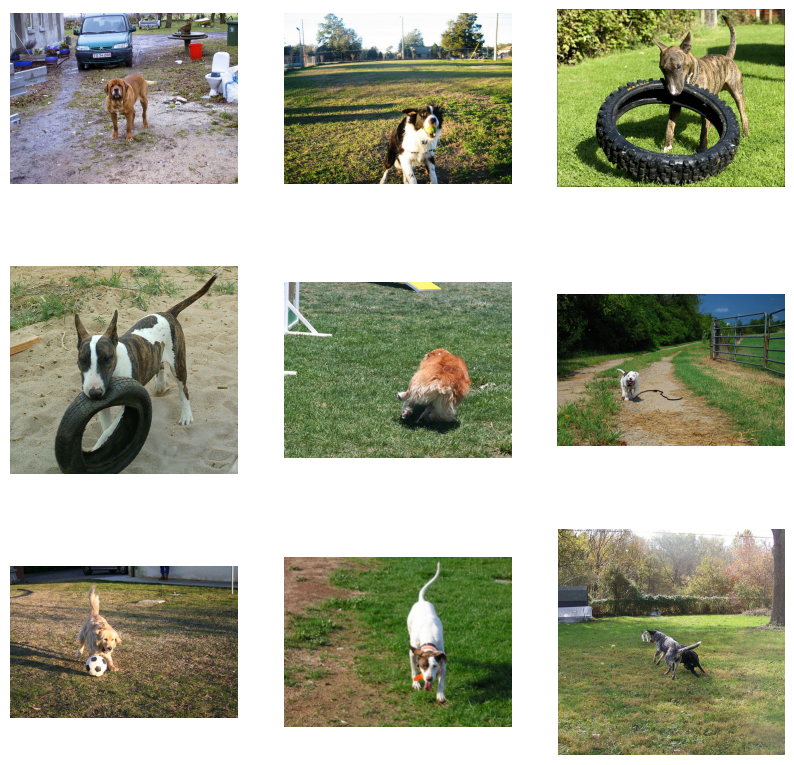

Matched image: 2098418613_85a0c9afea.jpg
Matched image: 3185695861_86152b2755.jpg
Matched image: 2890075175_4bd32b201a.jpg
Matched image: 452345346_afe1248586.jpg
Matched image: 2565237642_bdd46d7cef.jpg
Matched image: 2822290399_97c809d43b.jpg
Matched image: 3284887033_e2e48f1863.jpg
Matched image: 3103264875_2a8d534abc.jpg
Matched image: 1926129518_4350f4f552.jpg

Testing query: 'a child drawing with crayons'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


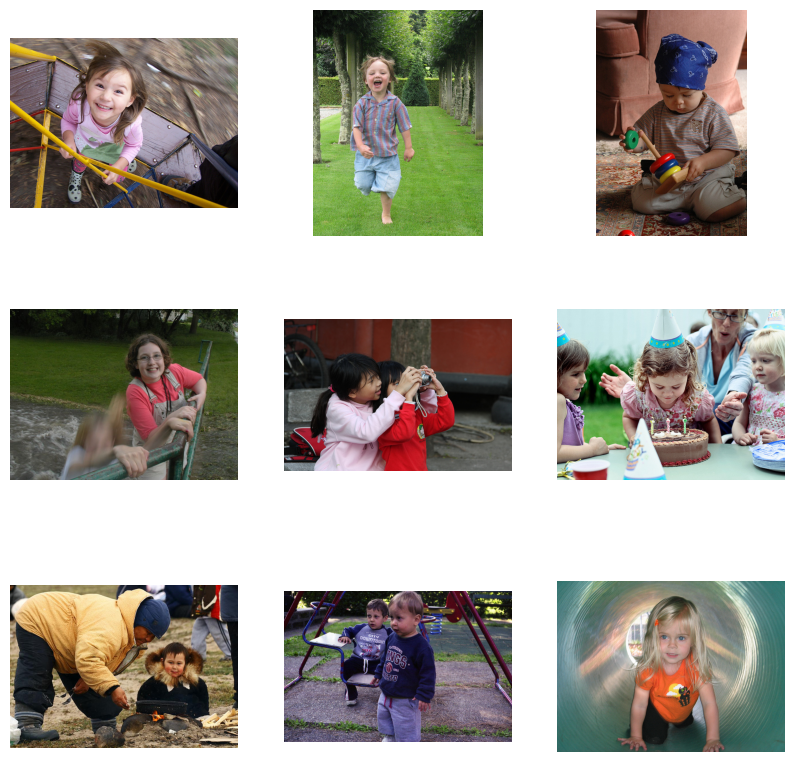

Matched image: 444057017_f1e0fcaef7.jpg
Matched image: 3159092624_66af4e207e.jpg
Matched image: 2657301826_aab4c36e6c.jpg
Matched image: 1253264731_e7c689eca5.jpg
Matched image: 2102732029_9ae520914d.jpg
Matched image: 3653484549_f316590b0f.jpg
Matched image: 2665461736_595c87f0a3.jpg
Matched image: 2481003841_06086eafc2.jpg
Matched image: 2591455200_2319651f2f.jpg

Testing query: 'a farmer working in a rice field'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


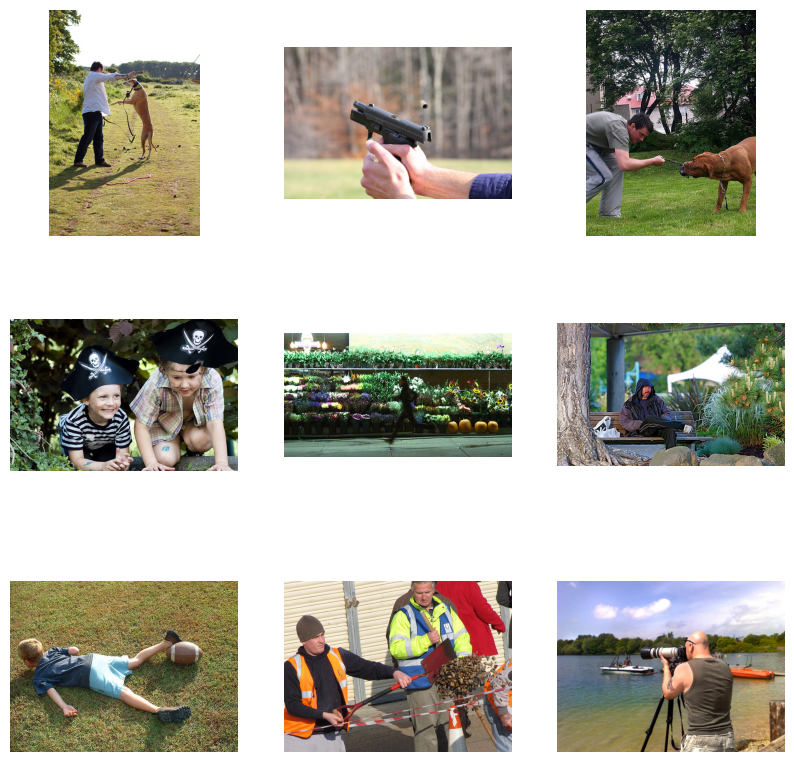

Matched image: 3558251719_3af5ae2d02.jpg
Matched image: 3005872315_e6771763bd.jpg
Matched image: 640506101_ae1145b6d1.jpg
Matched image: 522063319_33827f1627.jpg
Matched image: 2971298546_dd595cf297.jpg
Matched image: 2562166462_b43b141d40.jpg
Matched image: 1269470943_ba7fc49b4d.jpg
Matched image: 3332136681_9aecf101fd.jpg
Matched image: 3563461991_de05537878.jpg

Testing query: 'a close-up of a peacock spreading its feathers'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


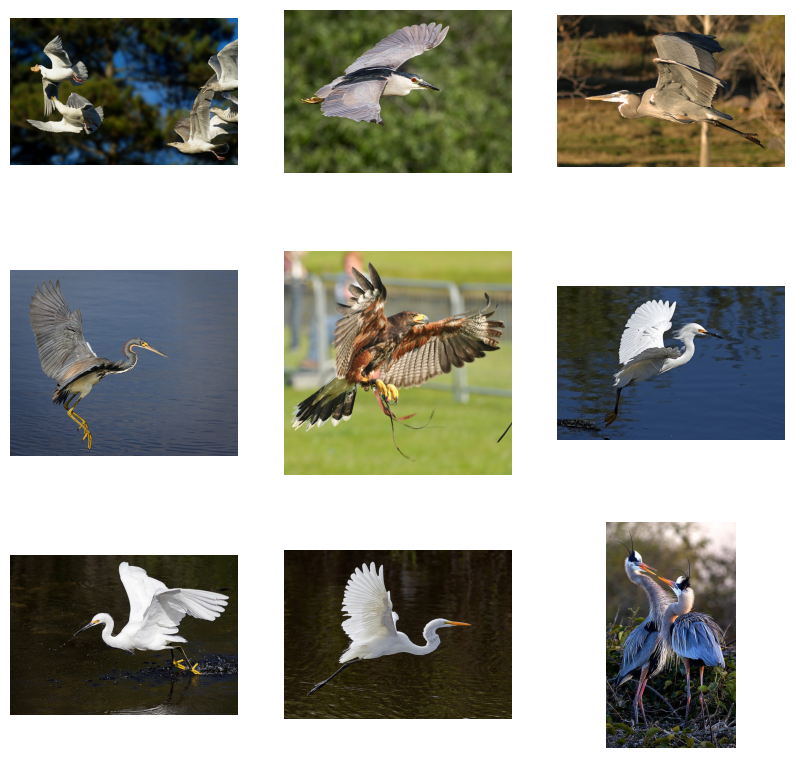

Matched image: 3294830188_e46bd9b93c.jpg
Matched image: 3331102049_bc65cf6198.jpg
Matched image: 3175712926_5a470d0886.jpg
Matched image: 3405113041_4b72c24801.jpg
Matched image: 3567061016_62768dcce1.jpg
Matched image: 3375070563_3c290a7991.jpg
Matched image: 3273969811_42e9fa8f63.jpg
Matched image: 3315110972_1090d11728.jpg
Matched image: 3189293145_35dea42679.jpg

Testing query: 'a biker riding through a forest trail'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


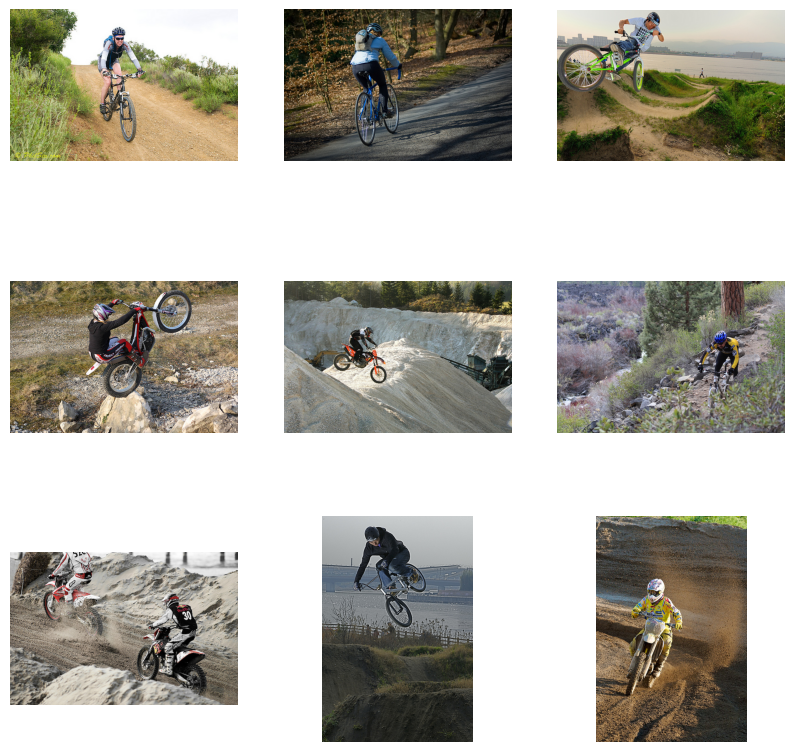

Matched image: 3551787566_b5ebbe2440.jpg
Matched image: 3346918203_986dca6641.jpg
Matched image: 3621329299_6fb3f2935c.jpg
Matched image: 3373243733_9aba7740ed.jpg
Matched image: 2990563425_2f7246f458.jpg
Matched image: 3474985382_26e1560338.jpg
Matched image: 3149804151_1cc8d10783.jpg
Matched image: 3429391520_930b153f94.jpg
Matched image: 3472449219_eb927f05b8.jpg

Testing query: 'a chef slicing vegetables in a restaurant kitchen'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


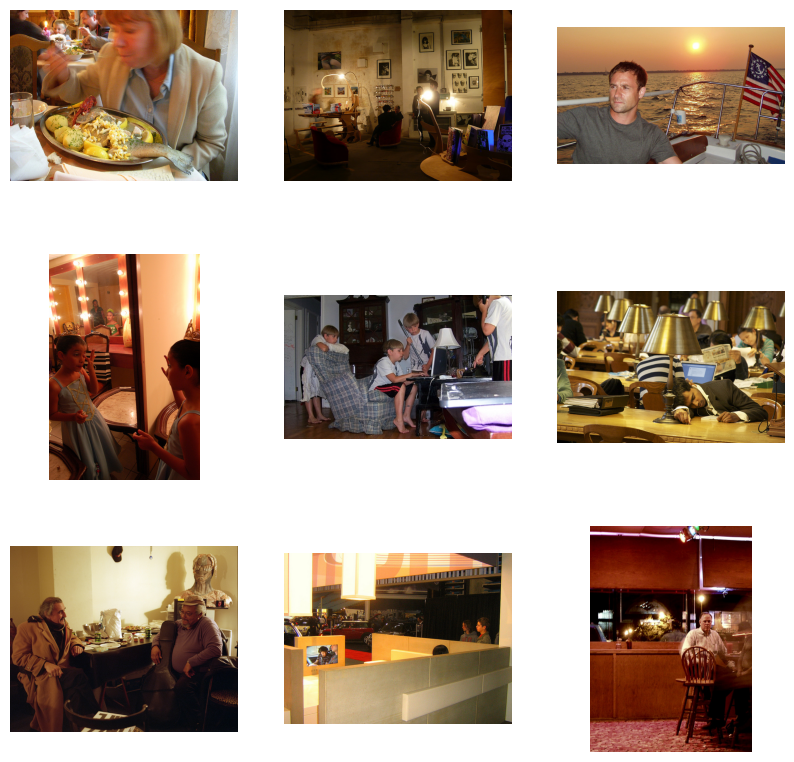

Matched image: 3118425885_f0cc035032.jpg
Matched image: 2575647360_f5de38c751.jpg
Matched image: 160805827_5e6646b753.jpg
Matched image: 3091594712_2166604334.jpg
Matched image: 576093768_e78f91c176.jpg
Matched image: 3574930742_9081bd2426.jpg
Matched image: 3371279606_c0d0cddab2.jpg
Matched image: 3215117062_6e07a86352.jpg
Matched image: 1460500597_866fa0c6f3.jpg

Testing query: 'a group of kids building a sandcastle on the beach'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


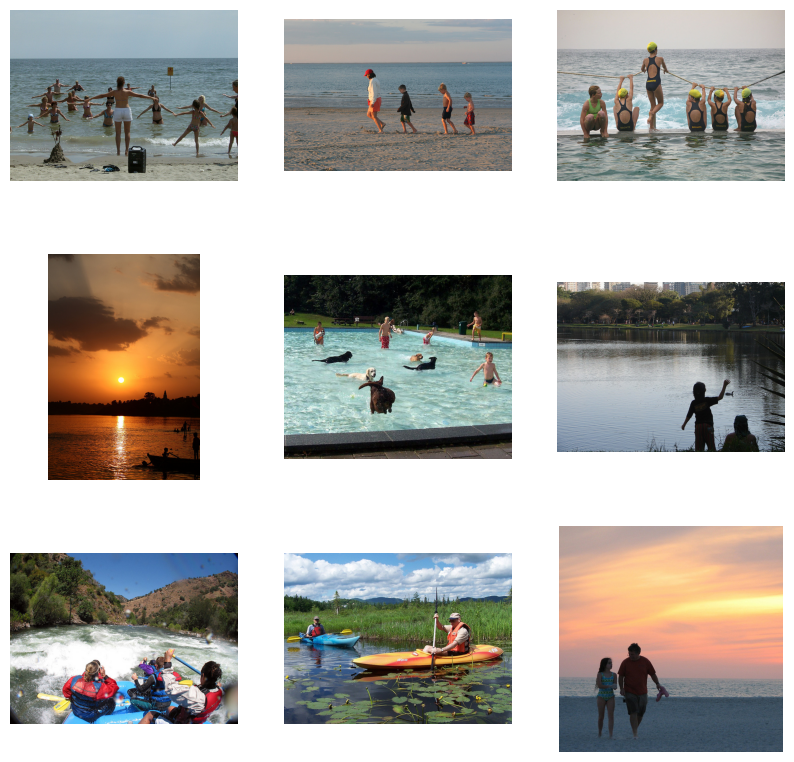

Matched image: 554526471_a31f8b74ef.jpg
Matched image: 716597900_b72c58362c.jpg
Matched image: 2114126343_a0f74ff63b.jpg
Matched image: 2900274587_f2cbca4c58.jpg
Matched image: 244571201_0339d8e8d1.jpg
Matched image: 1022454332_6af2c1449a.jpg
Matched image: 84713990_d3f3cef78b.jpg
Matched image: 2613889835_6f50a3b83b.jpg
Matched image: 3189002057_3ef61b803e.jpg

Testing query: 'an artist sketching a portrait'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


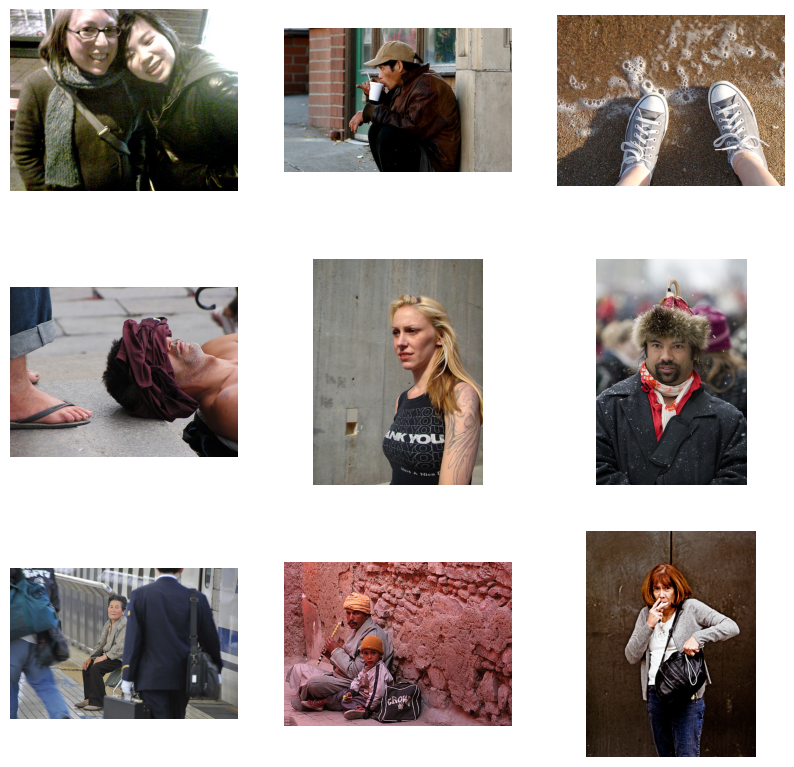

Matched image: 3121521593_18f0ec14f7.jpg
Matched image: 2853407781_c9fea8eef4.jpg
Matched image: 490390951_87395fcb1c.jpg
Matched image: 3282925526_535ff9f2b2.jpg
Matched image: 2726301121_95a2fbd22b.jpg
Matched image: 2083778090_3aecaa11cc.jpg
Matched image: 2938072630_d641b63e4d.jpg
Matched image: 3183195185_cd0ff994a1.jpg
Matched image: 2126950128_74a4882658.jpg

Testing query: 'a sunrise over a quiet lake'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


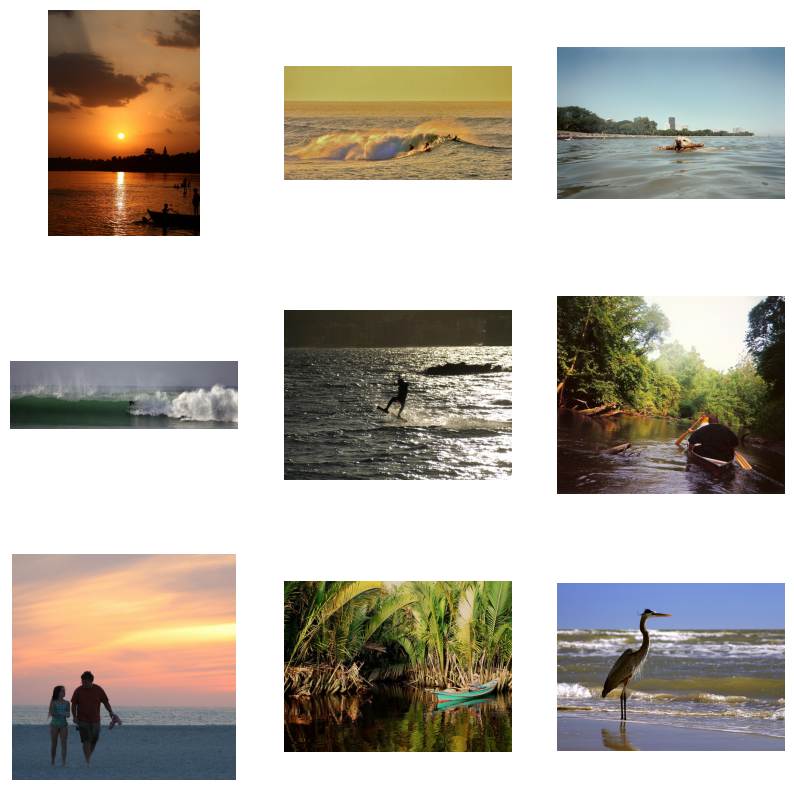

Matched image: 2900274587_f2cbca4c58.jpg
Matched image: 2976946039_fb9147908d.jpg
Matched image: 2870875612_2cbb9e4a3c.jpg
Matched image: 3050114829_18bc5a6d7c.jpg
Matched image: 3338590946_f25b76cbc7.jpg
Matched image: 136886677_6026c622eb.jpg
Matched image: 3189002057_3ef61b803e.jpg
Matched image: 3150659152_2ace03690b.jpg
Matched image: 99679241_adc853a5c0.jpg

Testing query: 'a city skyline with tall skyscrapers'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


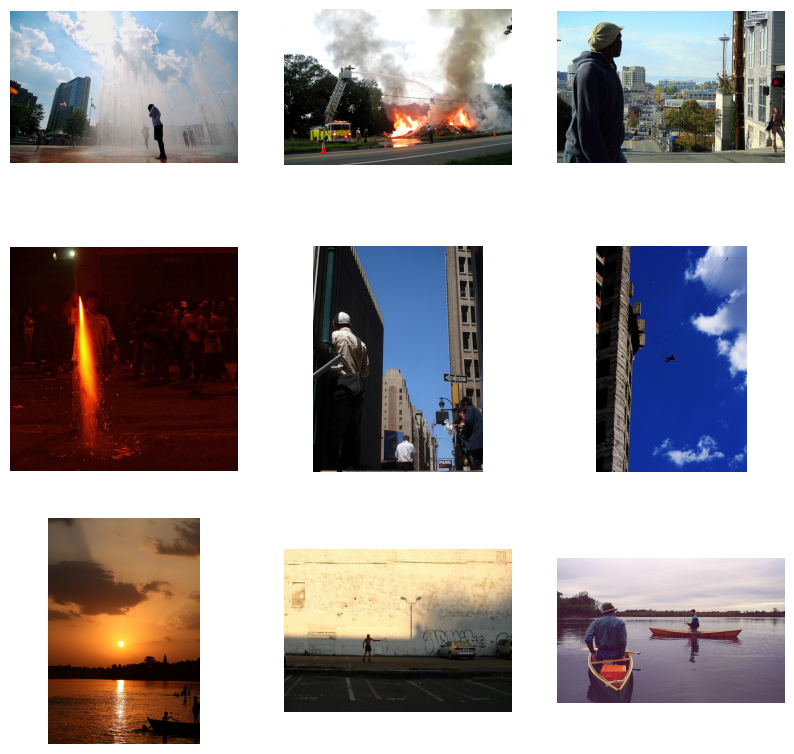

Matched image: 506882688_b37d549593.jpg
Matched image: 381052465_722e00807b.jpg
Matched image: 368212336_bc19b0bb72.jpg
Matched image: 3148571800_c5515e6c3d.jpg
Matched image: 561417861_8e25d0c0e8.jpg
Matched image: 3632225464_612d7b4c0f.jpg
Matched image: 2900274587_f2cbca4c58.jpg
Matched image: 1432179046_8e3d75cf81.jpg
Matched image: 3092200805_dd1f83ddbe.jpg

Testing query: 'a colorful parrot perched on a branch'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


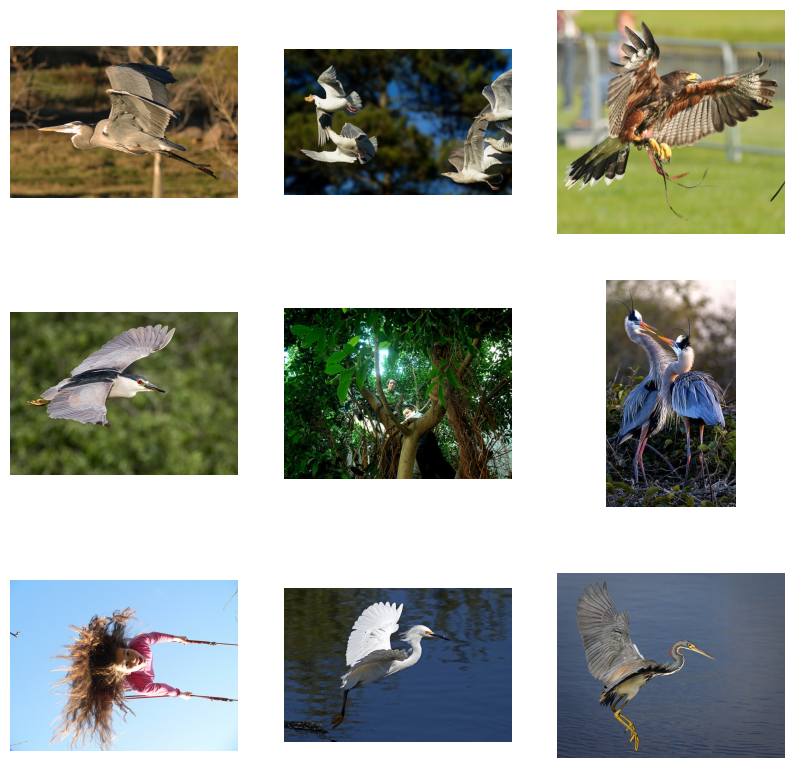

Matched image: 3175712926_5a470d0886.jpg
Matched image: 3294830188_e46bd9b93c.jpg
Matched image: 3567061016_62768dcce1.jpg
Matched image: 3331102049_bc65cf6198.jpg
Matched image: 1808504612_3508f3c9bb.jpg
Matched image: 3189293145_35dea42679.jpg
Matched image: 464251704_b0f0c4c87a.jpg
Matched image: 3375070563_3c290a7991.jpg
Matched image: 3405113041_4b72c24801.jpg

Testing query: 'a mechanic fixing a car in a garage'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


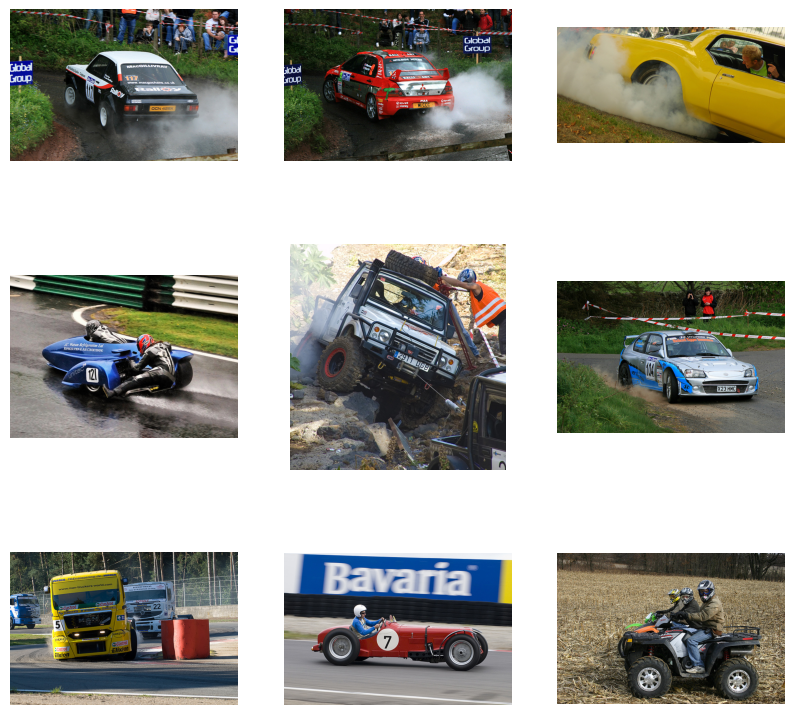

Matched image: 2527713011_b0ec25aa54.jpg
Matched image: 2528547068_7d37479b9b.jpg
Matched image: 311196733_03966b4836.jpg
Matched image: 3604314527_5077cd9d43.jpg
Matched image: 1466307485_5e6743332e.jpg
Matched image: 2522540026_6ee8ab4c6a.jpg
Matched image: 2862481071_86c65d46fa.jpg
Matched image: 1355945307_f9e01a9a05.jpg
Matched image: 109823394_83fcb735e1.jpg

Testing query: 'a scenic view of rolling hills'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


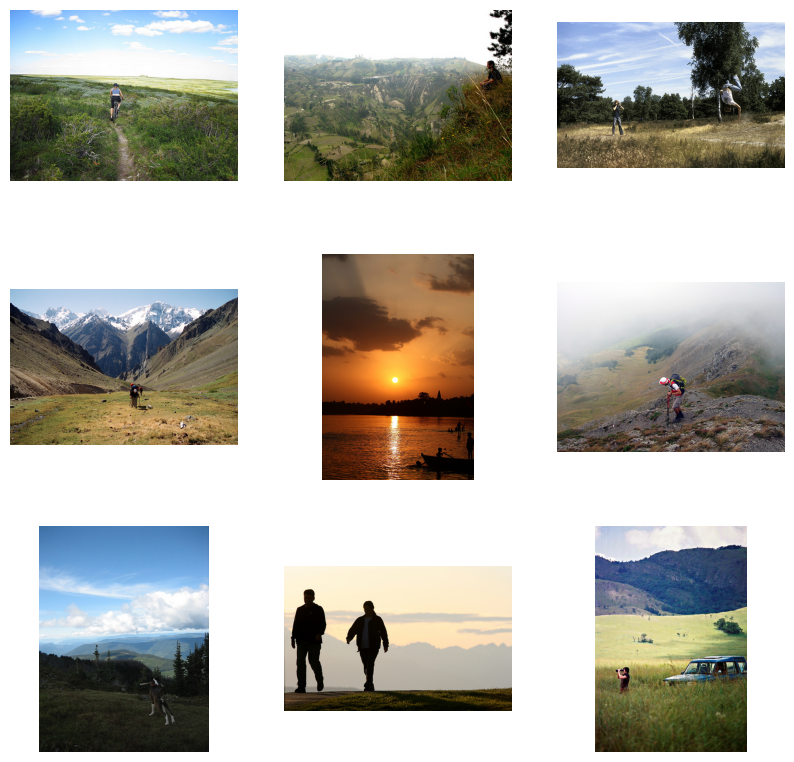

Matched image: 3676460610_8c52e8a355.jpg
Matched image: 3339747039_1a8455c210.jpg
Matched image: 207237775_fa0a15c6fe.jpg
Matched image: 444047125_66b249287c.jpg
Matched image: 2900274587_f2cbca4c58.jpg
Matched image: 2832978253_8fcc72da3b.jpg
Matched image: 2839038702_e168128665.jpg
Matched image: 530661899_94655d7d0e.jpg
Matched image: 2831215155_07ba8f1805.jpg

Testing query: 'a group of people at a concert'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


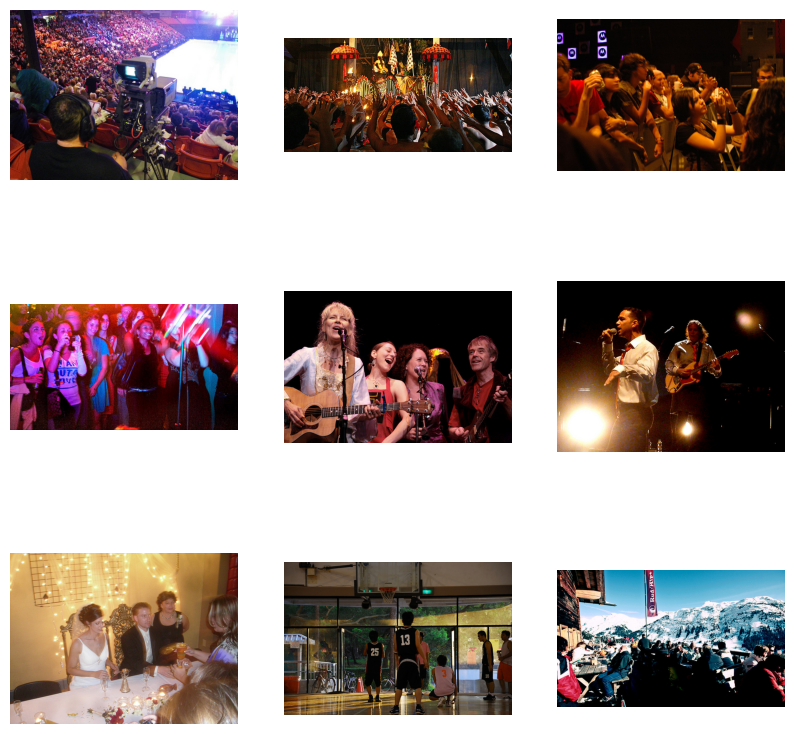

Matched image: 3089107423_81a24eaf18.jpg
Matched image: 2928835996_88b9f9503d.jpg
Matched image: 2074244690_82e30ff44b.jpg
Matched image: 3561130207_d1ed166daa.jpg
Matched image: 3627290893_561e176e80.jpg
Matched image: 3082196097_2d15455b00.jpg
Matched image: 3712574653_e009f76d19.jpg
Matched image: 3497234632_6ec740fc1e.jpg
Matched image: 3405011838_f81117c99f.jpg

Testing query: 'a plate of freshly baked cookies'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


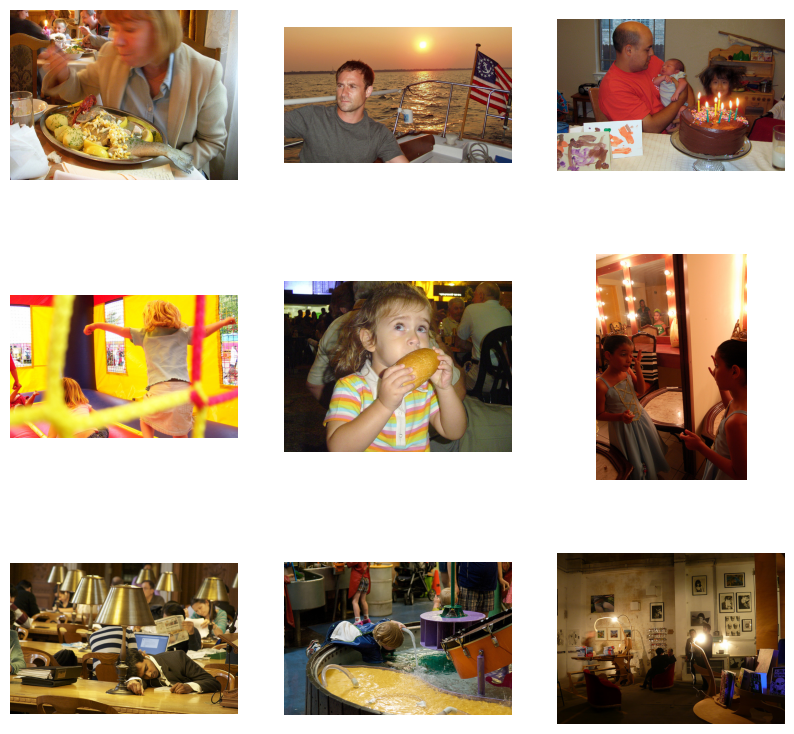

Matched image: 3118425885_f0cc035032.jpg
Matched image: 160805827_5e6646b753.jpg
Matched image: 3728695560_00ec1ca492.jpg
Matched image: 698107542_3aa0ba78b4.jpg
Matched image: 1459032057_97e73ed6ab.jpg
Matched image: 3091594712_2166604334.jpg
Matched image: 3574930742_9081bd2426.jpg
Matched image: 2746910139_77ba5be2c5.jpg
Matched image: 2575647360_f5de38c751.jpg

Testing query: 'a snowy path leading into a forest'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


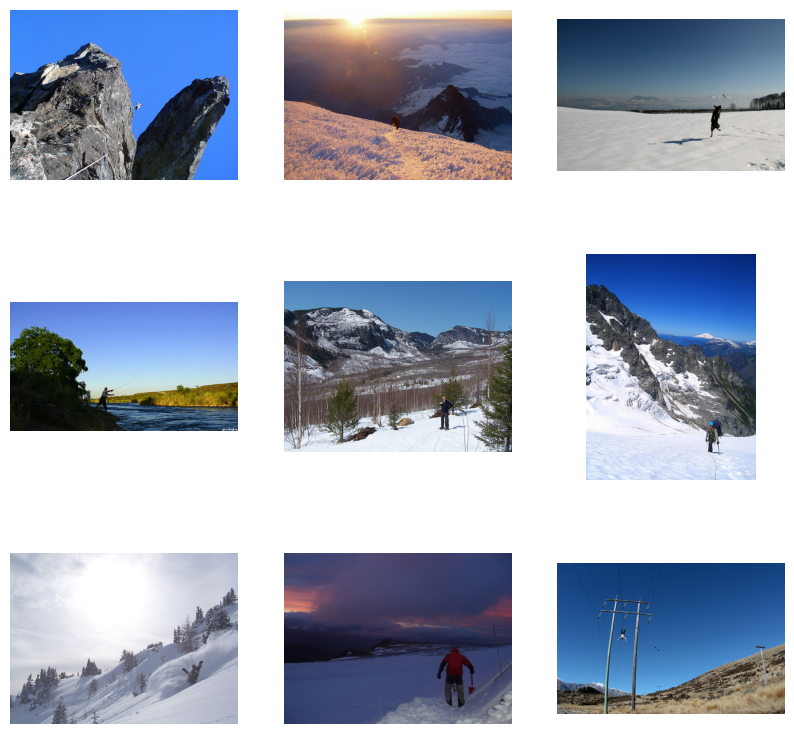

Matched image: 197107117_4b438b1872.jpg
Matched image: 223299142_521aedf9e7.jpg
Matched image: 3338217927_3c5cf3f7c6.jpg
Matched image: 2076865206_53918c820c.jpg
Matched image: 3621647714_fc67ab2617.jpg
Matched image: 58363930_0544844edd.jpg
Matched image: 2065309381_705b774f51.jpg
Matched image: 400851260_5911898657.jpg
Matched image: 1311388430_4ab0cd1a1f.jpg

Testing query: 'a fisherman rowing a small boat'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


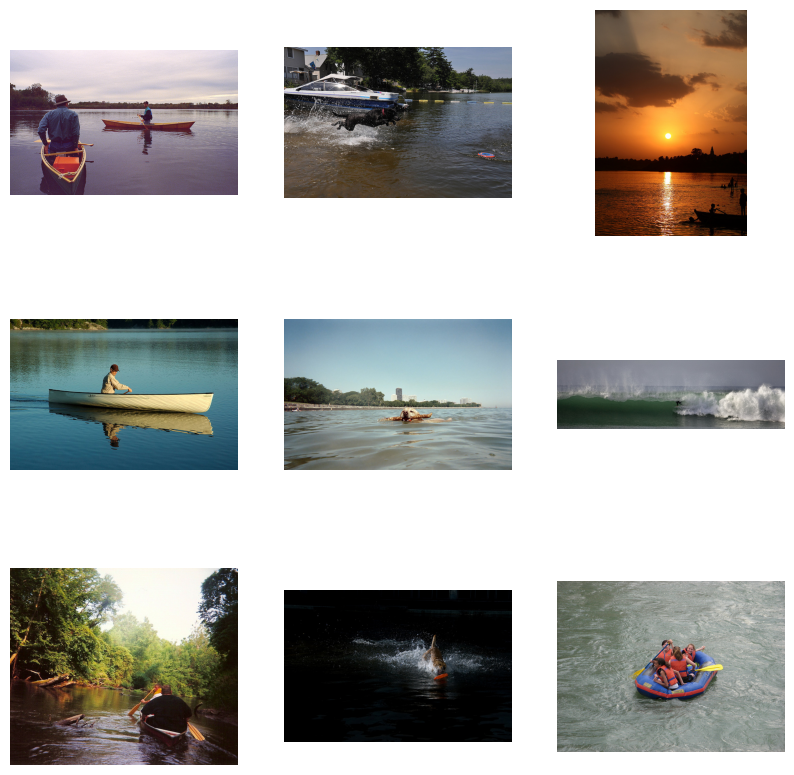

Matched image: 3092200805_dd1f83ddbe.jpg
Matched image: 3711611500_ea47b58b6f.jpg
Matched image: 2900274587_f2cbca4c58.jpg
Matched image: 229951087_4c20600c32.jpg
Matched image: 2870875612_2cbb9e4a3c.jpg
Matched image: 3050114829_18bc5a6d7c.jpg
Matched image: 136886677_6026c622eb.jpg
Matched image: 2744705574_519c171ca0.jpg
Matched image: 529198549_5cd9fedf3f.jpg

Testing query: 'a hiker reaching the peak of a mountain'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


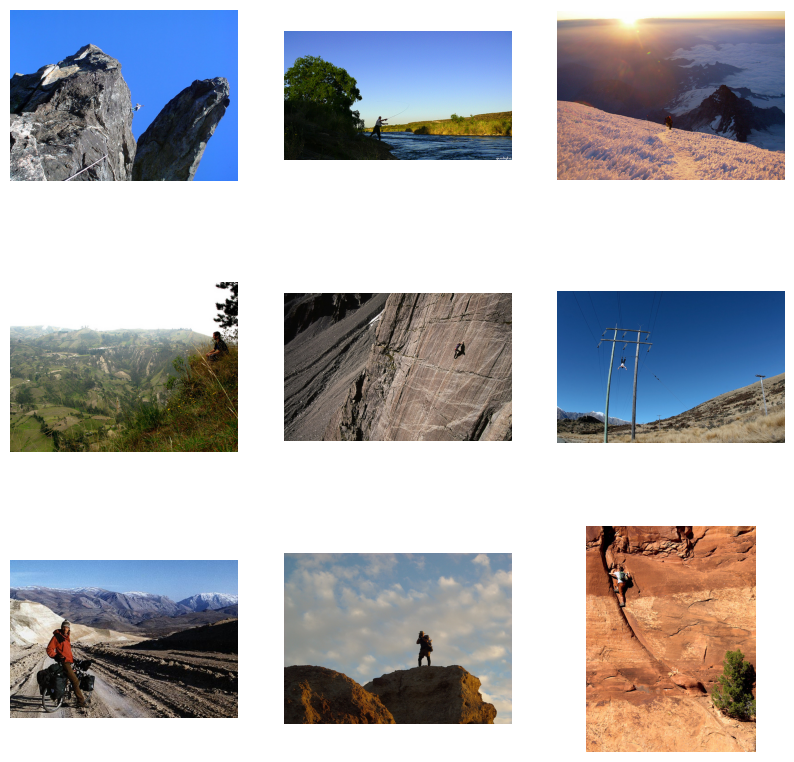

Matched image: 197107117_4b438b1872.jpg
Matched image: 2076865206_53918c820c.jpg
Matched image: 223299142_521aedf9e7.jpg
Matched image: 3339747039_1a8455c210.jpg
Matched image: 466956209_2ffcea3941.jpg
Matched image: 1311388430_4ab0cd1a1f.jpg
Matched image: 95734036_bef6d1a871.jpg
Matched image: 3443161359_65544fd732.jpg
Matched image: 2980348138_91cc6f6d0f.jpg

Testing query: 'a crowded subway station during rush hour'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


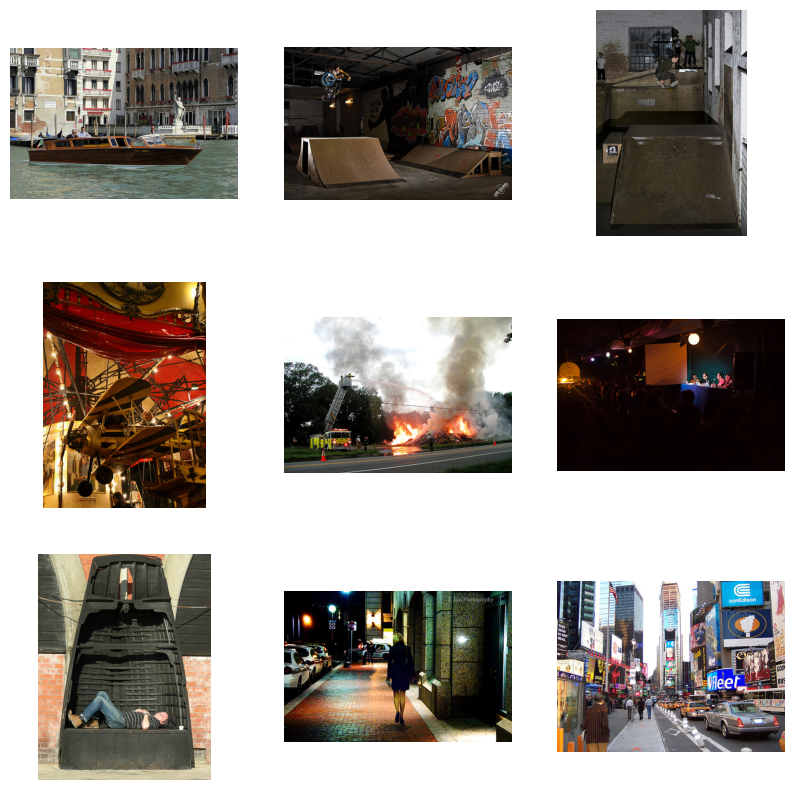

Matched image: 3549011001_26cace3646.jpg
Matched image: 2982881046_45765ced2c.jpg
Matched image: 3323988406_e3c8fce690.jpg
Matched image: 3057497487_57ecc60ff1.jpg
Matched image: 381052465_722e00807b.jpg
Matched image: 3643684688_2f7157b23d.jpg
Matched image: 2266061169_dfbf8f0595.jpg
Matched image: 1225443522_1633e7121f.jpg
Matched image: 1643915227_9f48068772.jpg

Testing query: 'a picnic with baskets and blankets in the park'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


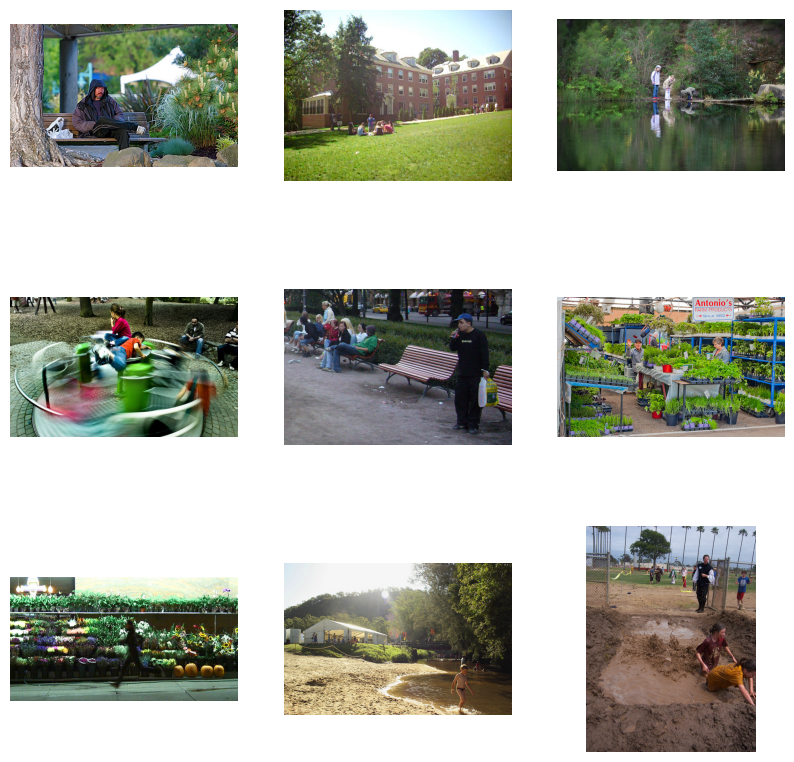

Matched image: 2562166462_b43b141d40.jpg
Matched image: 2847514745_9a35493023.jpg
Matched image: 1248357227_2b4175fc39.jpg
Matched image: 3537201804_ce07aff237.jpg
Matched image: 310213587_778fe8fb5b.jpg
Matched image: 3600403707_527aa0596e.jpg
Matched image: 2971298546_dd595cf297.jpg
Matched image: 3181322965_ce9da15271.jpg
Matched image: 2471493912_2d4746b834.jpg

Testing query: 'a person surfing on a big wave'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


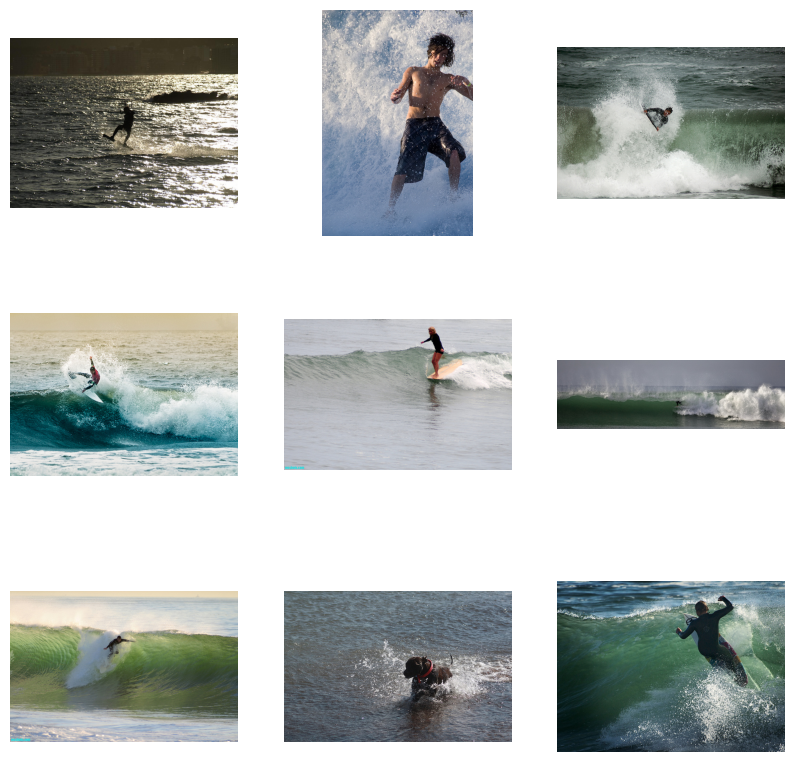

Matched image: 3338590946_f25b76cbc7.jpg
Matched image: 3341782693_426bf7139b.jpg
Matched image: 3631986552_944ea208fc.jpg
Matched image: 3403797144_53e49412ec.jpg
Matched image: 3627679667_0e3de9fc90.jpg
Matched image: 3050114829_18bc5a6d7c.jpg
Matched image: 3204922011_185e48949a.jpg
Matched image: 2934628301_41ea2e6cf9.jpg
Matched image: 3235076435_1eaa40bd0a.jpg

Testing query: 'a plane flying over a cityscape'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


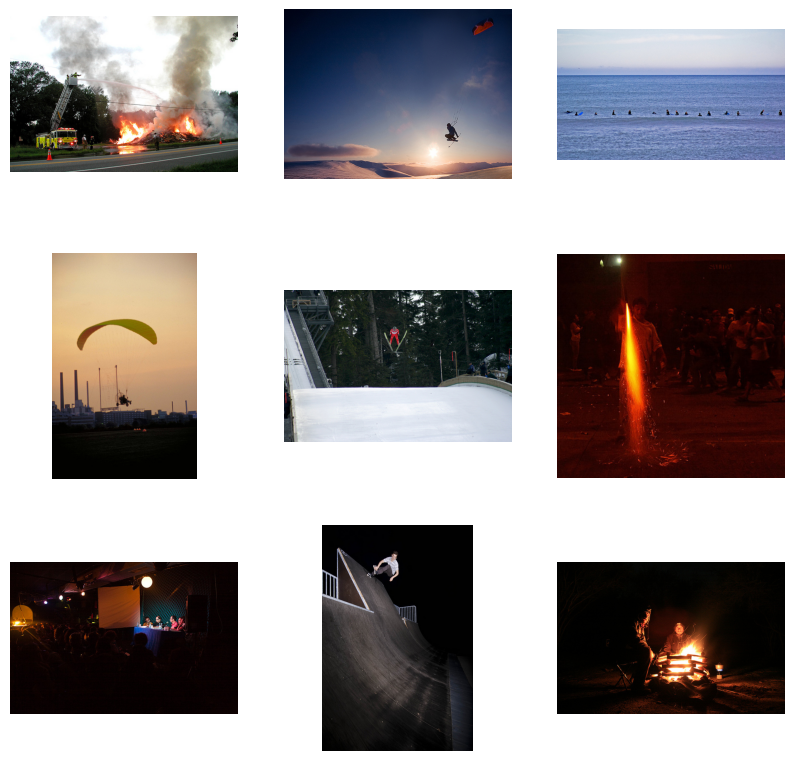

Matched image: 381052465_722e00807b.jpg
Matched image: 3359587274_4a2b140b84.jpg
Matched image: 3257182199_5fda78d870.jpg
Matched image: 265223847_636ba039c1.jpg
Matched image: 3223302125_f8154417f4.jpg
Matched image: 3148571800_c5515e6c3d.jpg
Matched image: 3643684688_2f7157b23d.jpg
Matched image: 3242263536_a436f19257.jpg
Matched image: 2610447973_89227ff978.jpg

Testing query: 'a lighthouse on a rocky shore'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


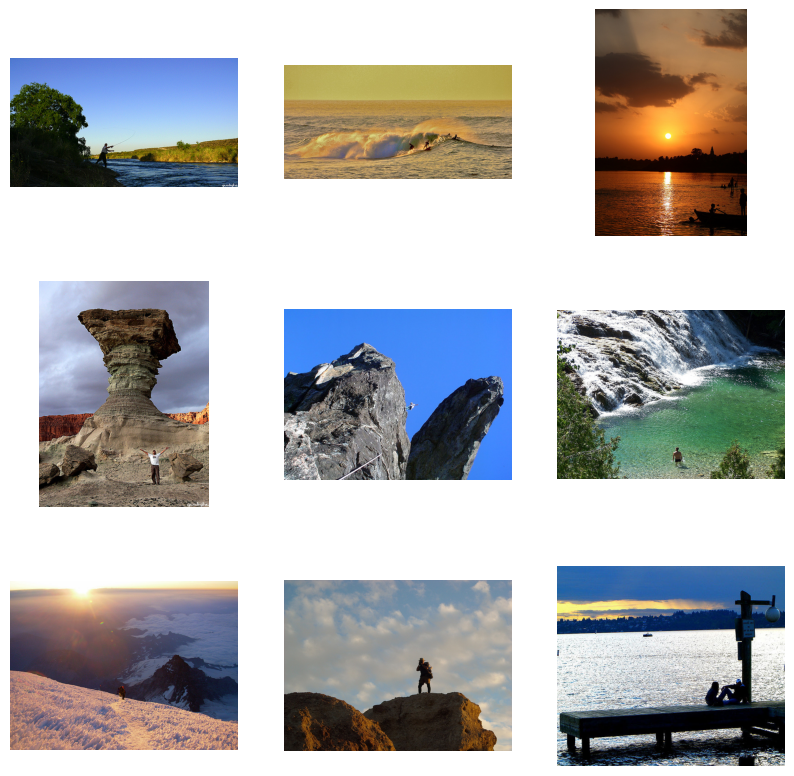

Matched image: 2076865206_53918c820c.jpg
Matched image: 2976946039_fb9147908d.jpg
Matched image: 2900274587_f2cbca4c58.jpg
Matched image: 457631171_12b1aee828.jpg
Matched image: 197107117_4b438b1872.jpg
Matched image: 1357724865_4faf4e1418.jpg
Matched image: 223299142_521aedf9e7.jpg
Matched image: 3443161359_65544fd732.jpg
Matched image: 42637986_135a9786a6.jpg

Testing query: 'a sunflower field on a sunny day'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


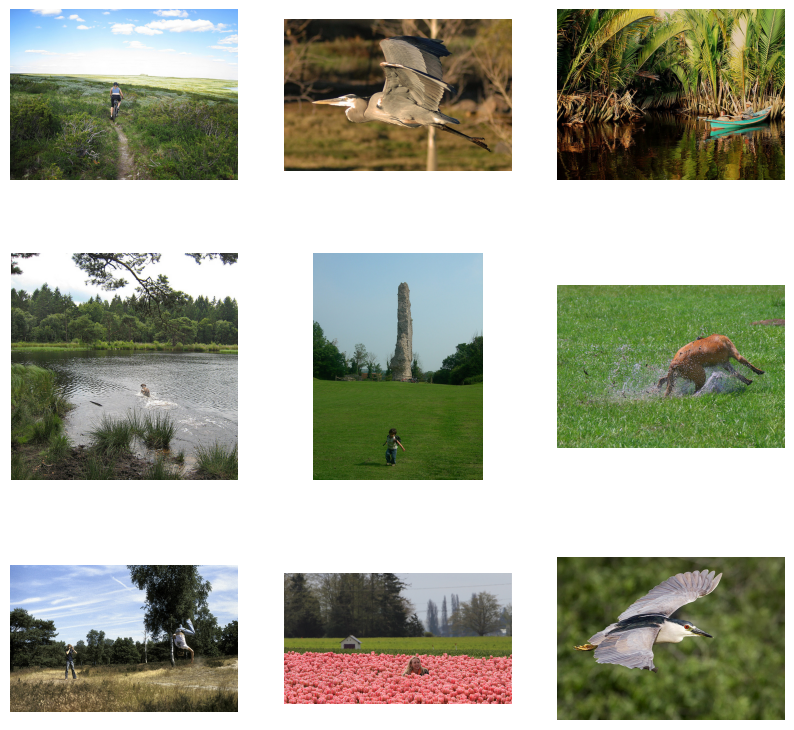

Matched image: 3676460610_8c52e8a355.jpg
Matched image: 3175712926_5a470d0886.jpg
Matched image: 3150659152_2ace03690b.jpg
Matched image: 610590753_cd69ce081a.jpg
Matched image: 537628742_146f2c24f8.jpg
Matched image: 3567214106_6ece483f8b.jpg
Matched image: 207237775_fa0a15c6fe.jpg
Matched image: 2483792149_a9b4ffecec.jpg
Matched image: 3331102049_bc65cf6198.jpg

Testing query: 'a family walking along a beach at sunset'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


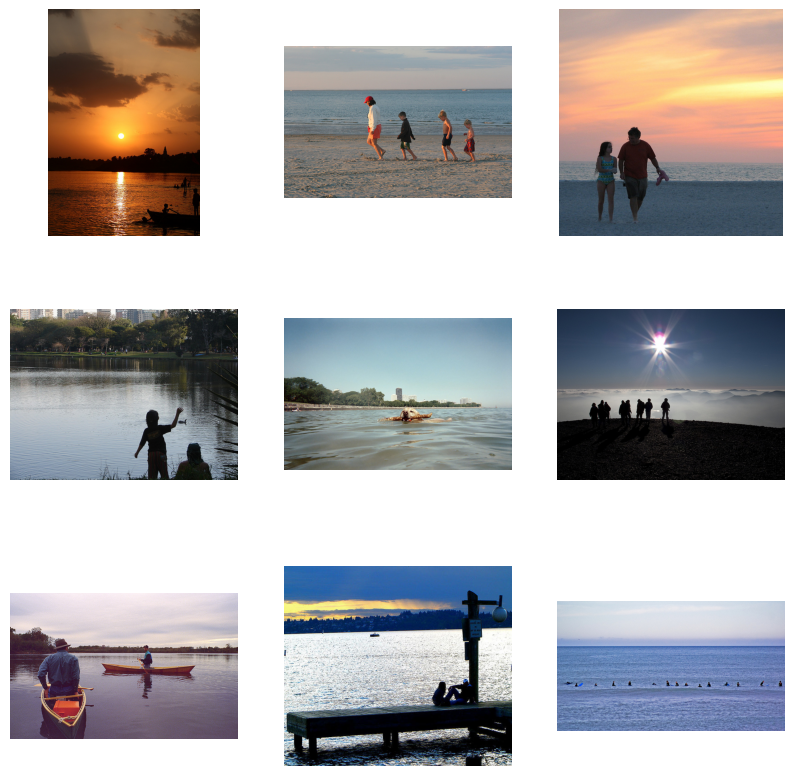

Matched image: 2900274587_f2cbca4c58.jpg
Matched image: 716597900_b72c58362c.jpg
Matched image: 3189002057_3ef61b803e.jpg
Matched image: 1022454332_6af2c1449a.jpg
Matched image: 2870875612_2cbb9e4a3c.jpg
Matched image: 3215847501_c723905ba4.jpg
Matched image: 3092200805_dd1f83ddbe.jpg
Matched image: 42637986_135a9786a6.jpg
Matched image: 3257182199_5fda78d870.jpg

Testing query: 'a chef flipping pancakes in a pan'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


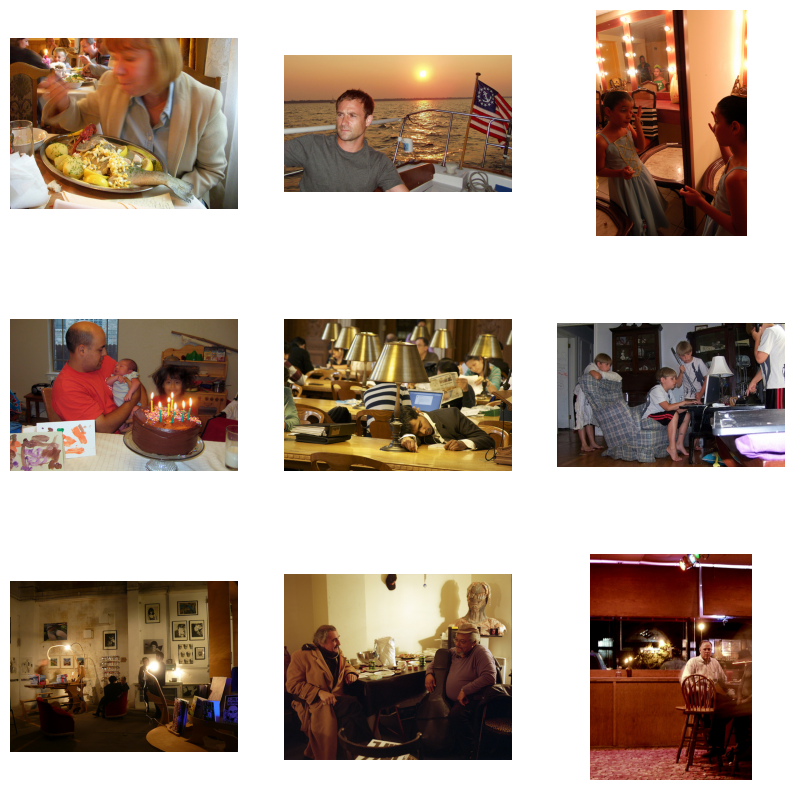

Matched image: 3118425885_f0cc035032.jpg
Matched image: 160805827_5e6646b753.jpg
Matched image: 3091594712_2166604334.jpg
Matched image: 3728695560_00ec1ca492.jpg
Matched image: 3574930742_9081bd2426.jpg
Matched image: 576093768_e78f91c176.jpg
Matched image: 2575647360_f5de38c751.jpg
Matched image: 3371279606_c0d0cddab2.jpg
Matched image: 1460500597_866fa0c6f3.jpg

Testing query: 'a child feeding ducks by a pond'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


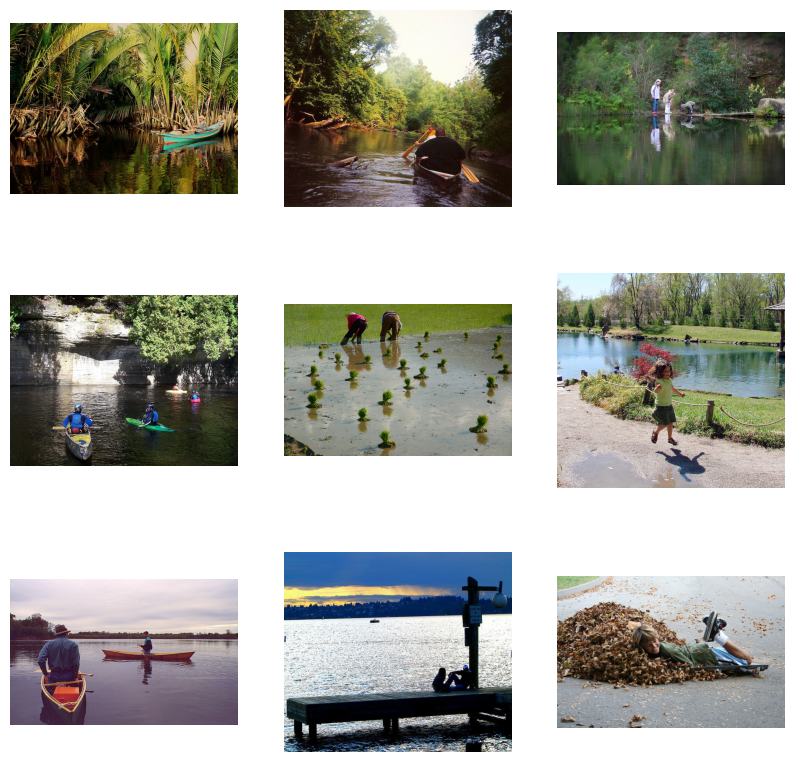

Matched image: 3150659152_2ace03690b.jpg
Matched image: 136886677_6026c622eb.jpg
Matched image: 1248357227_2b4175fc39.jpg
Matched image: 2906802485_dfebf09173.jpg
Matched image: 3275527950_41aca690a1.jpg
Matched image: 491964988_414b556228.jpg
Matched image: 3092200805_dd1f83ddbe.jpg
Matched image: 42637986_135a9786a6.jpg
Matched image: 3508522093_51f6d77f45.jpg

Testing query: 'a rainbow over a lush green valley'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


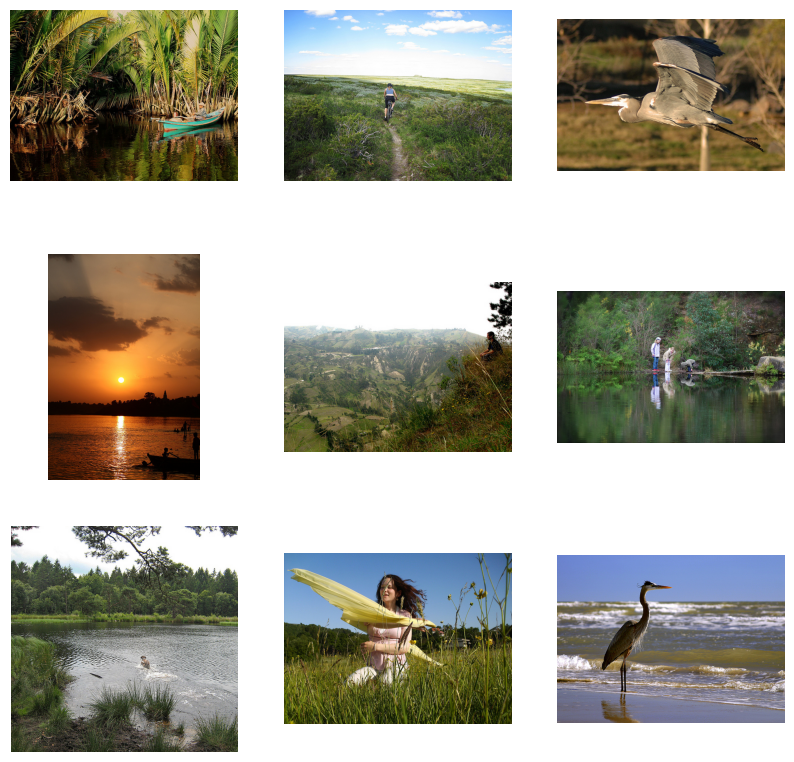

Matched image: 3150659152_2ace03690b.jpg
Matched image: 3676460610_8c52e8a355.jpg
Matched image: 3175712926_5a470d0886.jpg
Matched image: 2900274587_f2cbca4c58.jpg
Matched image: 3339747039_1a8455c210.jpg
Matched image: 1248357227_2b4175fc39.jpg
Matched image: 610590753_cd69ce081a.jpg
Matched image: 2909875716_25c8652614.jpg
Matched image: 99679241_adc853a5c0.jpg

Testing query: 'a football player kicking a goal'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


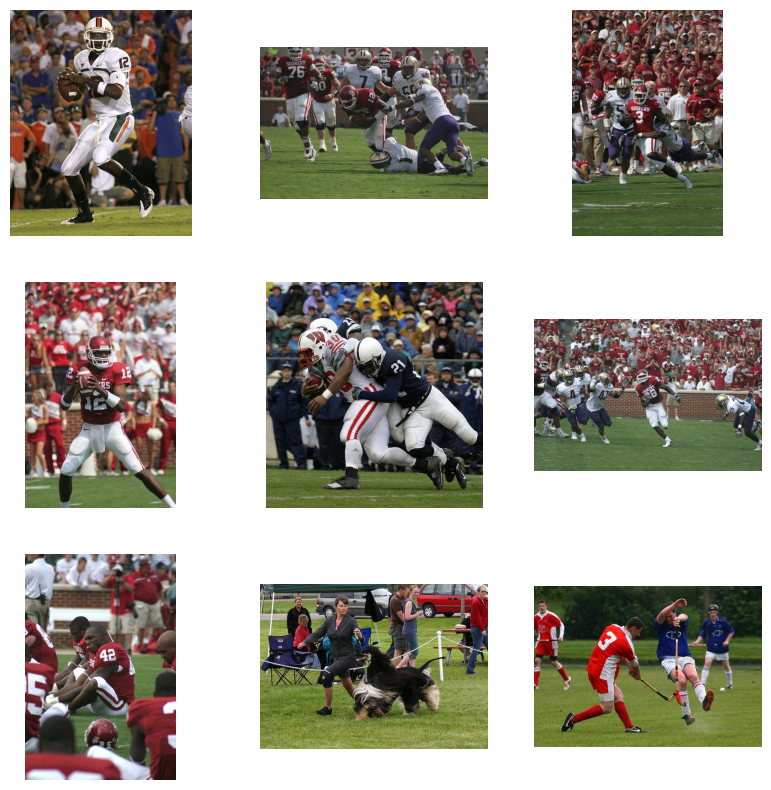

Matched image: 2838085973_42b6e9b5b1.jpg
Matched image: 241346471_c756a8f139.jpg
Matched image: 241347300_7c84ecf764.jpg
Matched image: 241347496_1a35fec8dc.jpg
Matched image: 3498997518_c2b16f0a0e.jpg
Matched image: 241346923_18bd84bea4.jpg
Matched image: 241347689_d0b1ac297d.jpg
Matched image: 2616673985_fa4354cc53.jpg
Matched image: 3557295488_600d387347.jpg

Testing query: 'a close-up of a bumblebee on a flower'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


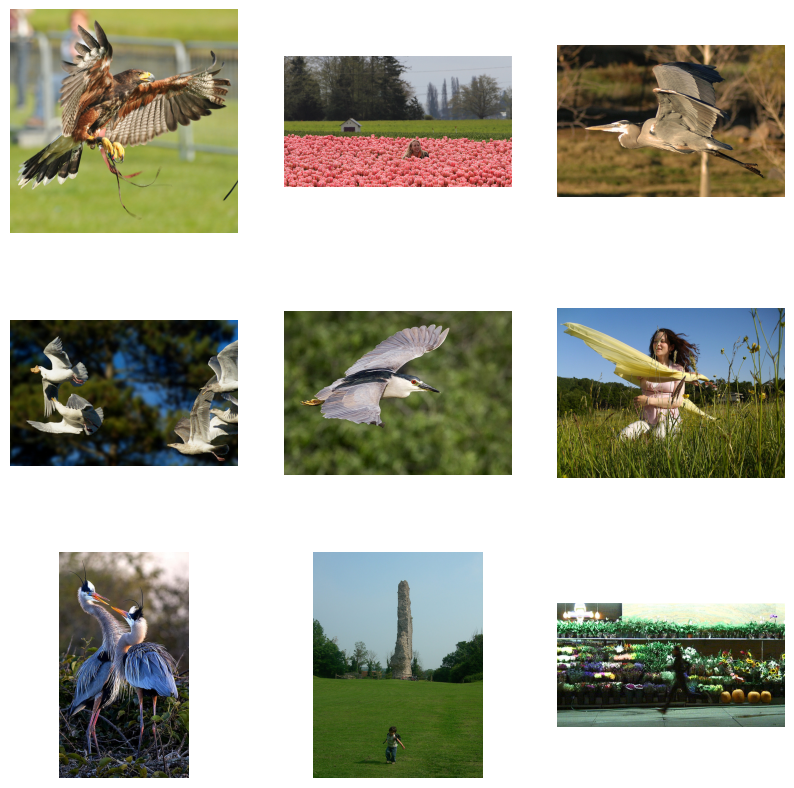

Matched image: 3567061016_62768dcce1.jpg
Matched image: 2483792149_a9b4ffecec.jpg
Matched image: 3175712926_5a470d0886.jpg
Matched image: 3294830188_e46bd9b93c.jpg
Matched image: 3331102049_bc65cf6198.jpg
Matched image: 2909875716_25c8652614.jpg
Matched image: 3189293145_35dea42679.jpg
Matched image: 537628742_146f2c24f8.jpg
Matched image: 2971298546_dd595cf297.jpg

Testing query: 'a musician playing a violin in an orchestra'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


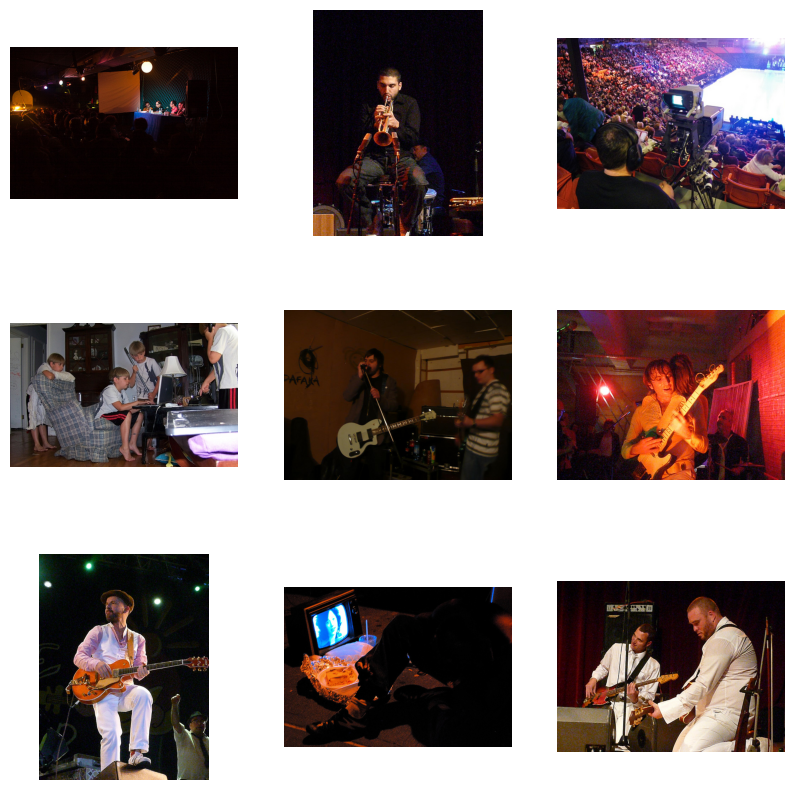

Matched image: 3643684688_2f7157b23d.jpg
Matched image: 3247500085_c4f641aa84.jpg
Matched image: 3089107423_81a24eaf18.jpg
Matched image: 576093768_e78f91c176.jpg
Matched image: 3332202255_a30c522664.jpg
Matched image: 3592968286_b63c81bcd2.jpg
Matched image: 3723690961_729dd5d617.jpg
Matched image: 1045521051_108ebc19be.jpg
Matched image: 3351360323_91bb341350.jpg

Testing query: 'a city street lit up with neon signs'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


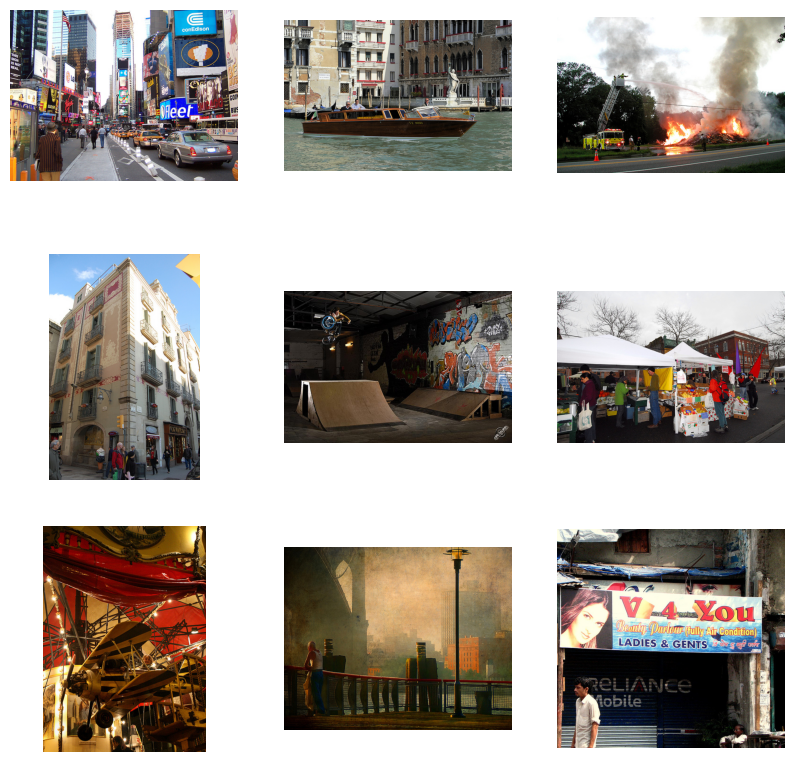

Matched image: 1643915227_9f48068772.jpg
Matched image: 3549011001_26cace3646.jpg
Matched image: 381052465_722e00807b.jpg
Matched image: 3253060519_55d98c208f.jpg
Matched image: 2982881046_45765ced2c.jpg
Matched image: 380537190_11d6c0a412.jpg
Matched image: 3057497487_57ecc60ff1.jpg
Matched image: 2565703445_dd6899bc0e.jpg
Matched image: 531197115_2be4d5034b.jpg

Testing query: 'a woman meditating by a waterfall'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


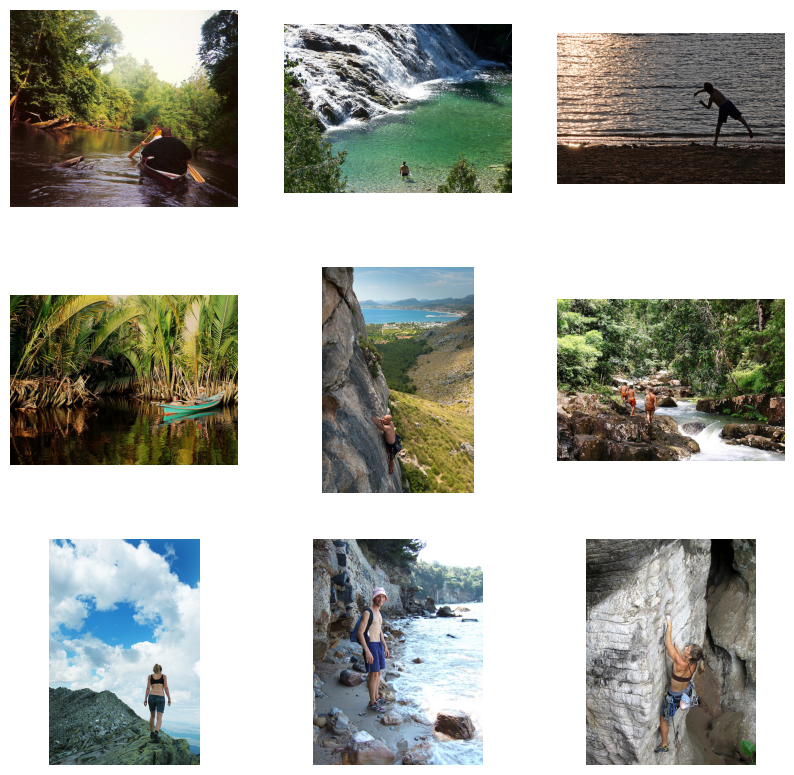

Matched image: 136886677_6026c622eb.jpg
Matched image: 1357724865_4faf4e1418.jpg
Matched image: 3705688385_47651205d3.jpg
Matched image: 3150659152_2ace03690b.jpg
Matched image: 3699763582_f28c5130dd.jpg
Matched image: 3014015906_fdba461f36.jpg
Matched image: 3690107455_0fdb4ecee7.jpg
Matched image: 2162564553_96de62c7e6.jpg
Matched image: 314904143_5a216a192b.jpg

Testing query: 'a farmer’s market with fresh produce'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


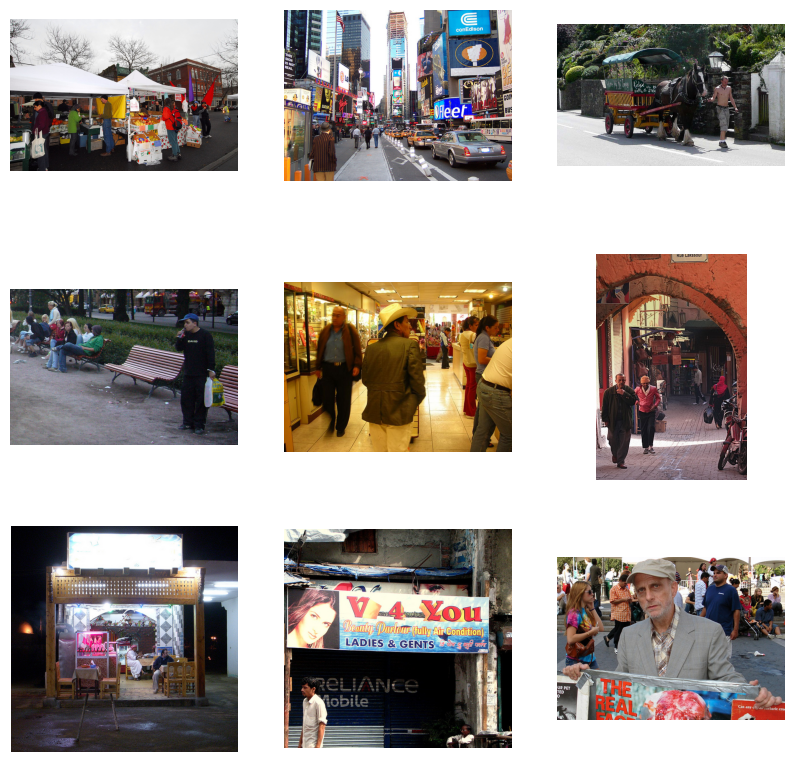

Matched image: 380537190_11d6c0a412.jpg
Matched image: 1643915227_9f48068772.jpg
Matched image: 1149179852_acad4d7300.jpg
Matched image: 310213587_778fe8fb5b.jpg
Matched image: 2261550615_b6c25d987b.jpg
Matched image: 3518334317_bc40bae18d.jpg
Matched image: 3366571152_20afb88ac1.jpg
Matched image: 531197115_2be4d5034b.jpg
Matched image: 251958970_fa6b423f23.jpg

Testing query: 'a group of dancers on a stage'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


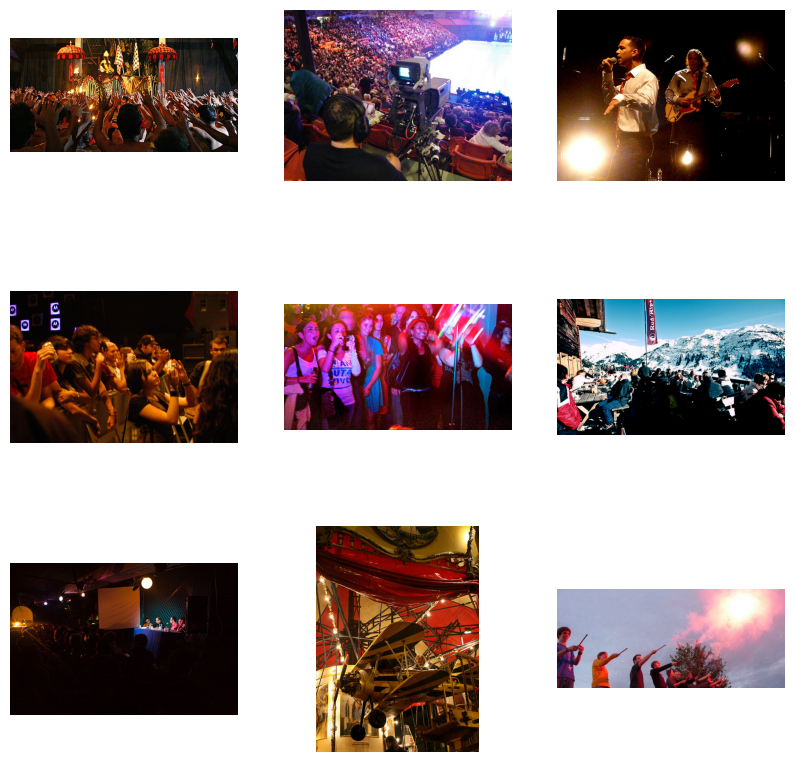

Matched image: 2928835996_88b9f9503d.jpg
Matched image: 3089107423_81a24eaf18.jpg
Matched image: 3082196097_2d15455b00.jpg
Matched image: 2074244690_82e30ff44b.jpg
Matched image: 3561130207_d1ed166daa.jpg
Matched image: 3405011838_f81117c99f.jpg
Matched image: 3643684688_2f7157b23d.jpg
Matched image: 3057497487_57ecc60ff1.jpg
Matched image: 3211029717_2affe6bbd5.jpg

Testing query: 'a couple having dinner at a candle-lit restaurant'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


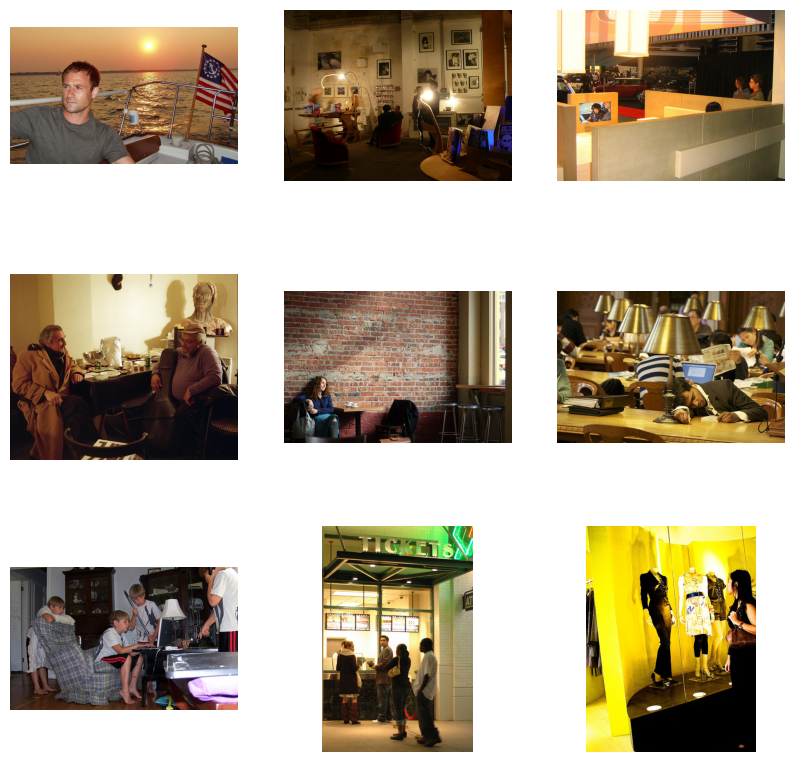

Matched image: 160805827_5e6646b753.jpg
Matched image: 2575647360_f5de38c751.jpg
Matched image: 3215117062_6e07a86352.jpg
Matched image: 3371279606_c0d0cddab2.jpg
Matched image: 409327234_7b29eecb4e.jpg
Matched image: 3574930742_9081bd2426.jpg
Matched image: 576093768_e78f91c176.jpg
Matched image: 2244551043_21b8cca866.jpg
Matched image: 1386251841_5f384a0fea.jpg

Testing query: 'a bustling street market in the evening'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


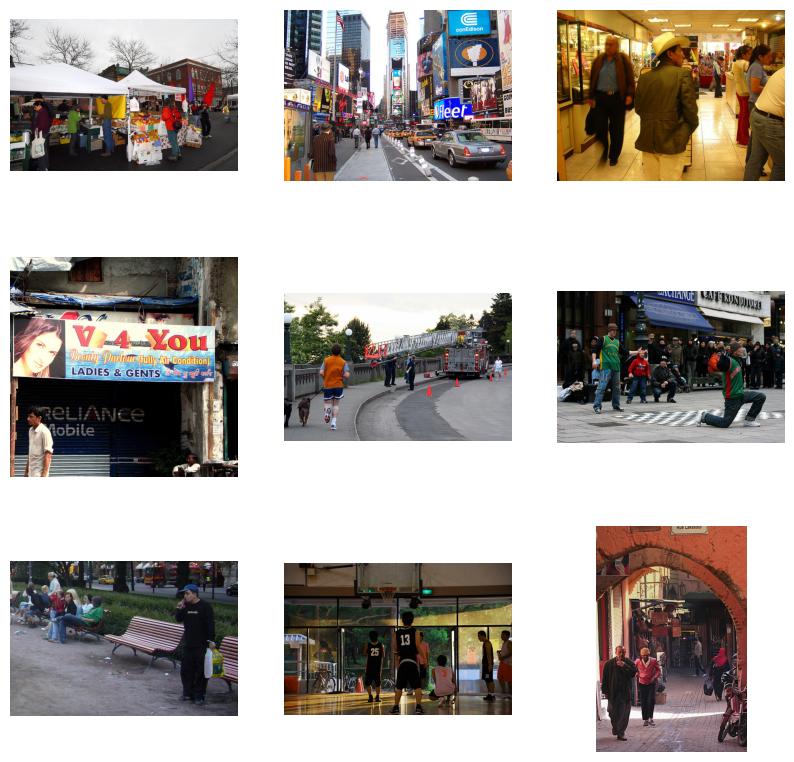

Matched image: 380537190_11d6c0a412.jpg
Matched image: 1643915227_9f48068772.jpg
Matched image: 2261550615_b6c25d987b.jpg
Matched image: 531197115_2be4d5034b.jpg
Matched image: 542179694_e170e9e465.jpg
Matched image: 3259992638_0612a40288.jpg
Matched image: 310213587_778fe8fb5b.jpg
Matched image: 3497234632_6ec740fc1e.jpg
Matched image: 3518334317_bc40bae18d.jpg

Testing query: 'a person on a swing under a tree'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


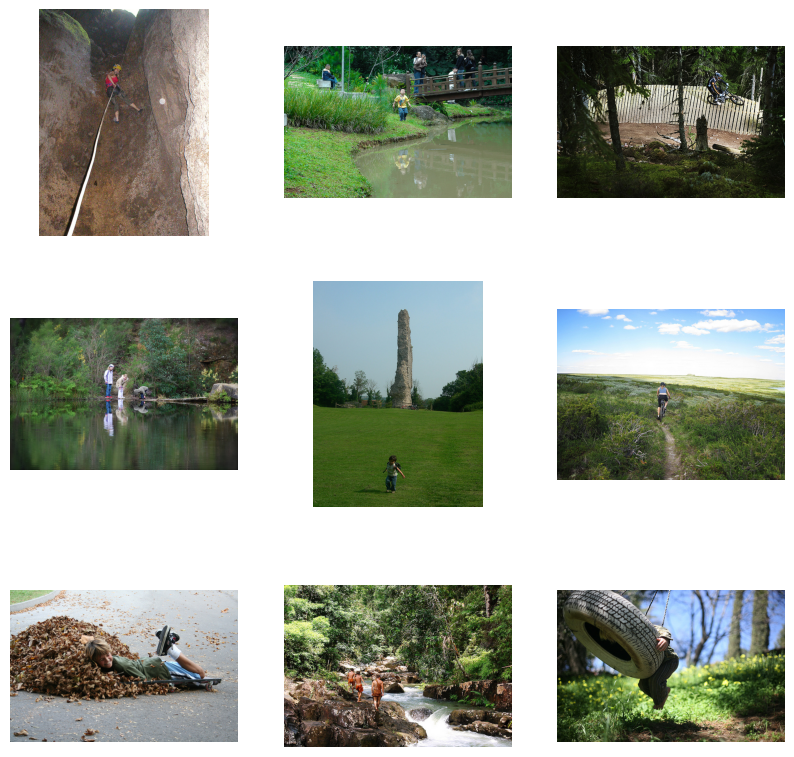

Matched image: 109260216_85b0be5378.jpg
Matched image: 2394919002_ed7527ff93.jpg
Matched image: 3027365101_3818be6e16.jpg
Matched image: 1248357227_2b4175fc39.jpg
Matched image: 537628742_146f2c24f8.jpg
Matched image: 3676460610_8c52e8a355.jpg
Matched image: 3508522093_51f6d77f45.jpg
Matched image: 3014015906_fdba461f36.jpg
Matched image: 2313822078_282dc07531.jpg

Testing query: 'a skier gliding down a snowy mountain'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


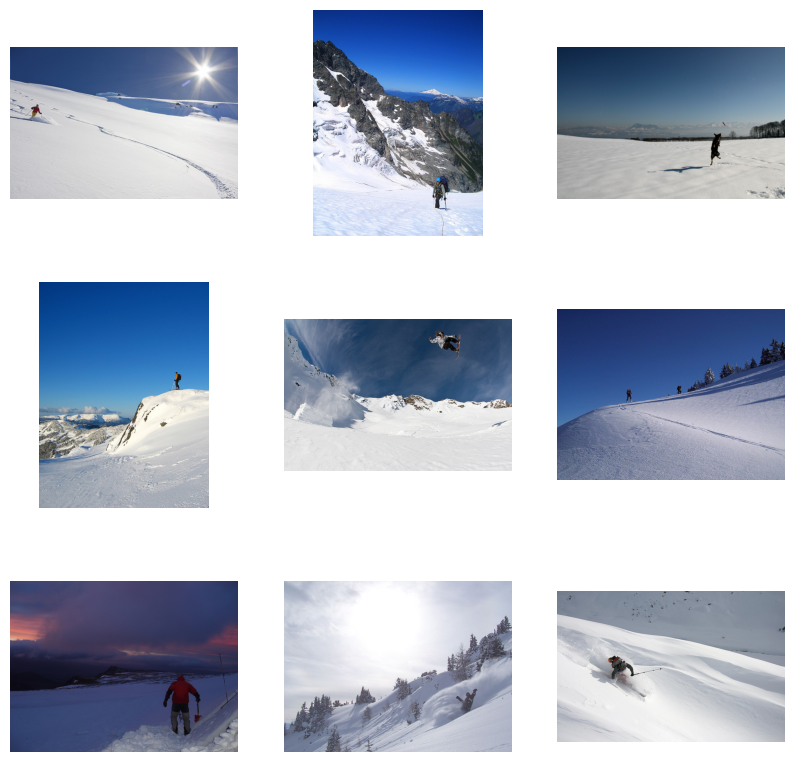

Matched image: 3273403495_fcd09c453e.jpg
Matched image: 58363930_0544844edd.jpg
Matched image: 3338217927_3c5cf3f7c6.jpg
Matched image: 106514190_bae200f463.jpg
Matched image: 3238654429_d899e34287.jpg
Matched image: 108899015_bf36131a57.jpg
Matched image: 400851260_5911898657.jpg
Matched image: 2065309381_705b774f51.jpg
Matched image: 3156406419_38fbd52007.jpg

Testing query: 'a sunrise casting light over the desert'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


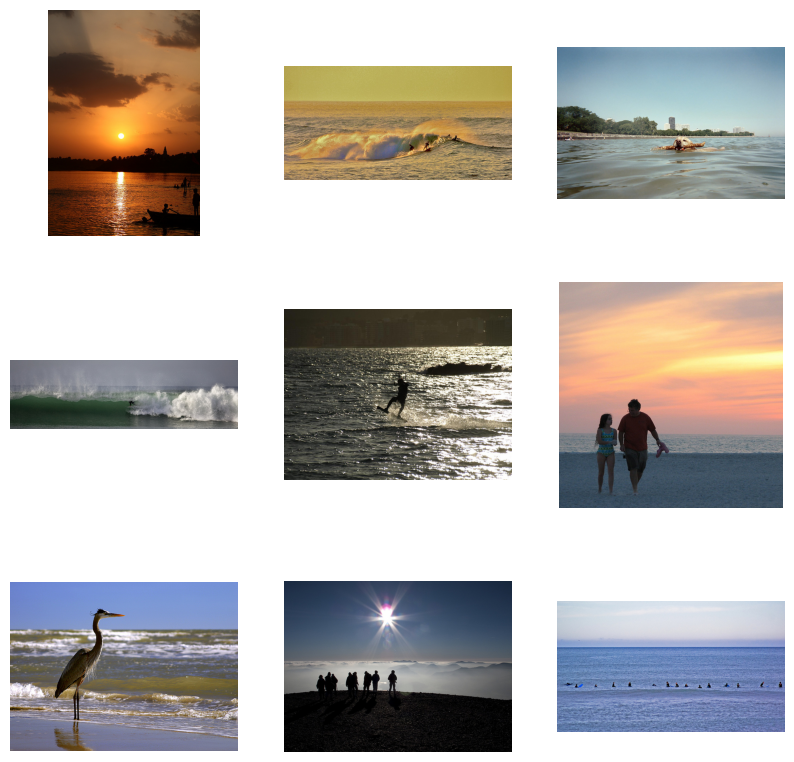

Matched image: 2900274587_f2cbca4c58.jpg
Matched image: 2976946039_fb9147908d.jpg
Matched image: 2870875612_2cbb9e4a3c.jpg
Matched image: 3050114829_18bc5a6d7c.jpg
Matched image: 3338590946_f25b76cbc7.jpg
Matched image: 3189002057_3ef61b803e.jpg
Matched image: 99679241_adc853a5c0.jpg
Matched image: 3215847501_c723905ba4.jpg
Matched image: 3257182199_5fda78d870.jpg

Testing query: 'a person kayaking in a river canyon'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


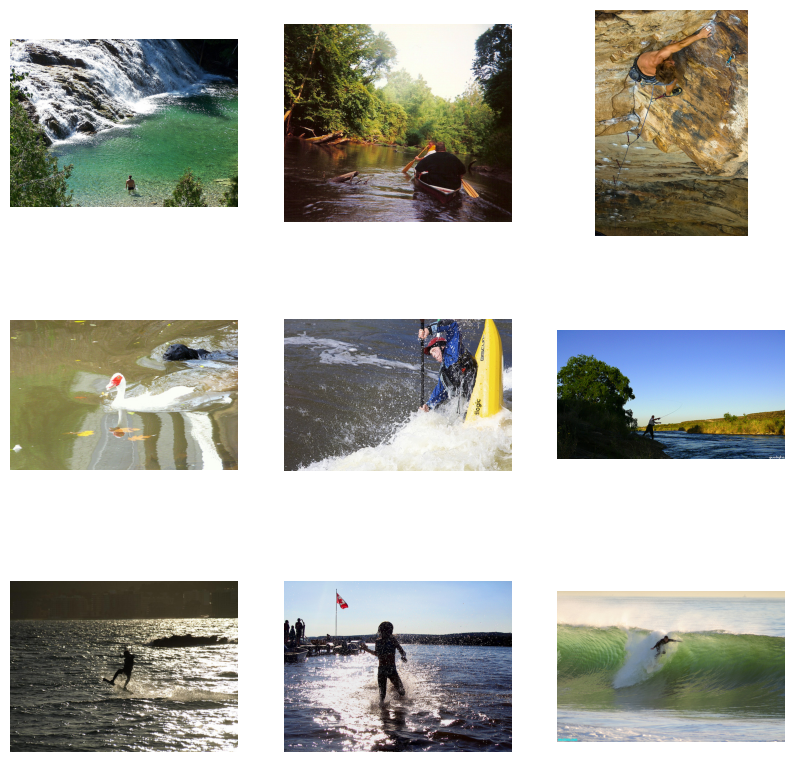

Matched image: 1357724865_4faf4e1418.jpg
Matched image: 136886677_6026c622eb.jpg
Matched image: 1355450069_c0675b0706.jpg
Matched image: 298920219_9a3f80acc5.jpg
Matched image: 3397633339_d1ae6d9a0e.jpg
Matched image: 2076865206_53918c820c.jpg
Matched image: 3338590946_f25b76cbc7.jpg
Matched image: 510791586_3913ade6a7.jpg
Matched image: 3204922011_185e48949a.jpg

Testing query: 'a baker preparing dough in a bakery'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


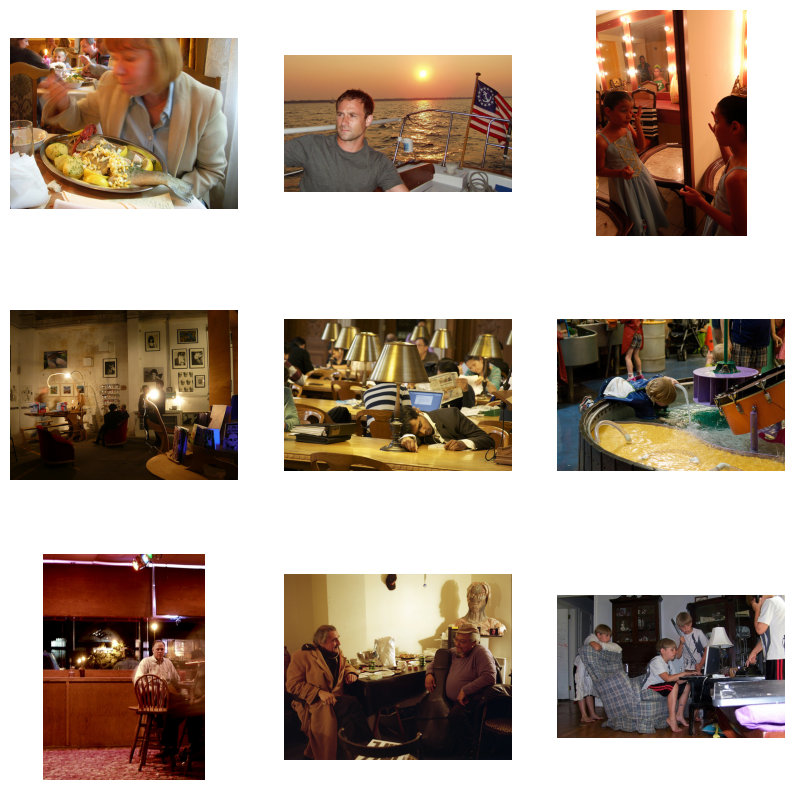

Matched image: 3118425885_f0cc035032.jpg
Matched image: 160805827_5e6646b753.jpg
Matched image: 3091594712_2166604334.jpg
Matched image: 2575647360_f5de38c751.jpg
Matched image: 3574930742_9081bd2426.jpg
Matched image: 2746910139_77ba5be2c5.jpg
Matched image: 1460500597_866fa0c6f3.jpg
Matched image: 3371279606_c0d0cddab2.jpg
Matched image: 576093768_e78f91c176.jpg

Testing query: 'a close-up of a ladybug on a leaf'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


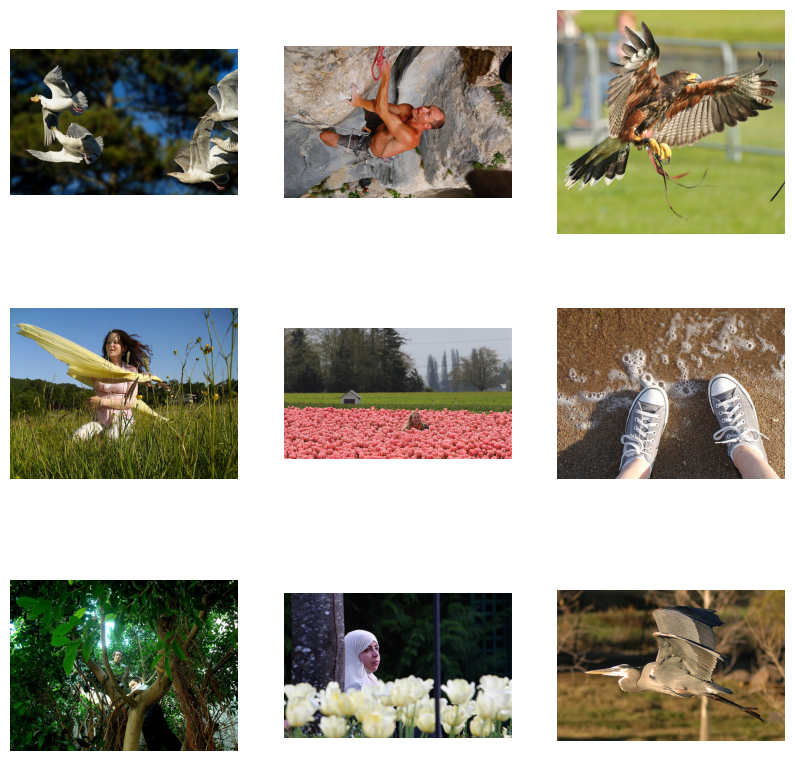

Matched image: 3294830188_e46bd9b93c.jpg
Matched image: 2540360421_f7c2401da8.jpg
Matched image: 3567061016_62768dcce1.jpg
Matched image: 2909875716_25c8652614.jpg
Matched image: 2483792149_a9b4ffecec.jpg
Matched image: 490390951_87395fcb1c.jpg
Matched image: 1808504612_3508f3c9bb.jpg
Matched image: 2533010184_ef2fd71297.jpg
Matched image: 3175712926_5a470d0886.jpg

Testing query: 'a police officer directing traffic'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


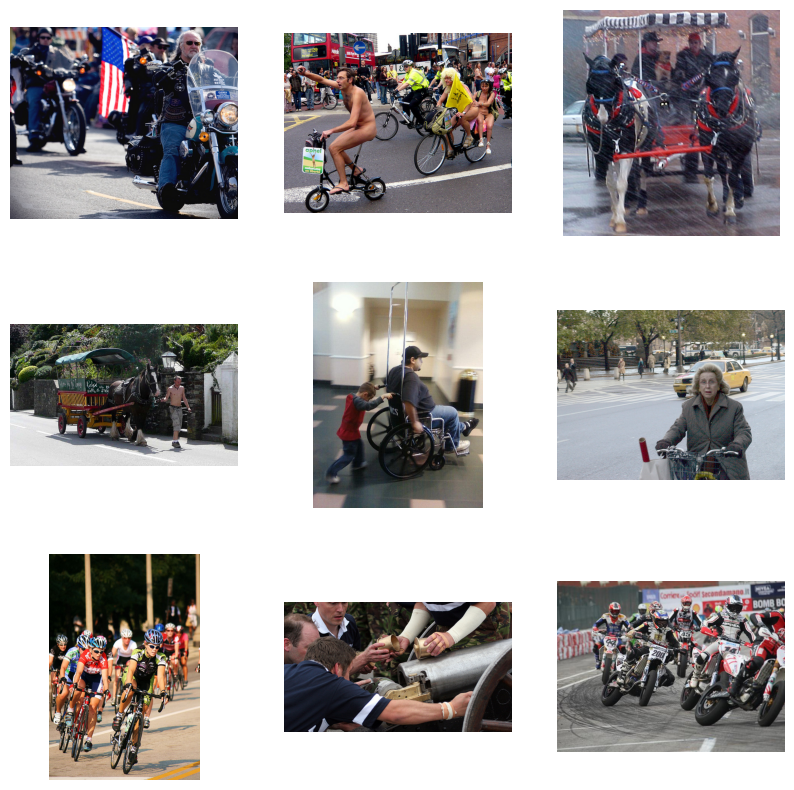

Matched image: 2471974379_a4a4d2b389.jpg
Matched image: 2581066814_179d28f306.jpg
Matched image: 97731718_eb7ba71fd3.jpg
Matched image: 1149179852_acad4d7300.jpg
Matched image: 3021780428_497542a072.jpg
Matched image: 2083434441_a93bc6306b.jpg
Matched image: 2708176152_1634cb754d.jpg
Matched image: 3504881781_6a842e043b.jpg
Matched image: 3043685748_130db75e3b.jpg

Testing query: 'a bridge over a flowing river'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


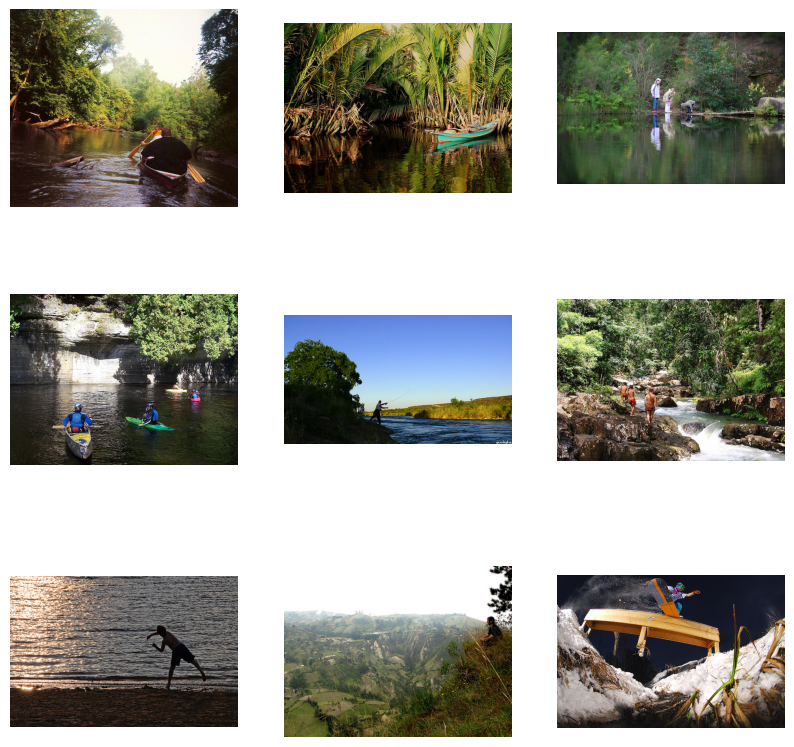

Matched image: 136886677_6026c622eb.jpg
Matched image: 3150659152_2ace03690b.jpg
Matched image: 1248357227_2b4175fc39.jpg
Matched image: 2906802485_dfebf09173.jpg
Matched image: 2076865206_53918c820c.jpg
Matched image: 3014015906_fdba461f36.jpg
Matched image: 3705688385_47651205d3.jpg
Matched image: 3339747039_1a8455c210.jpg
Matched image: 3198962089_e647d1b0cd.jpg

Testing query: 'a child playing in a pile of autumn leaves'
FAISS Index Type: <class 'faiss.swigfaiss_avx2.IndexFlatIP'>
FAISS Index Dimensions: 256
Number of Vectors in Index: 8090


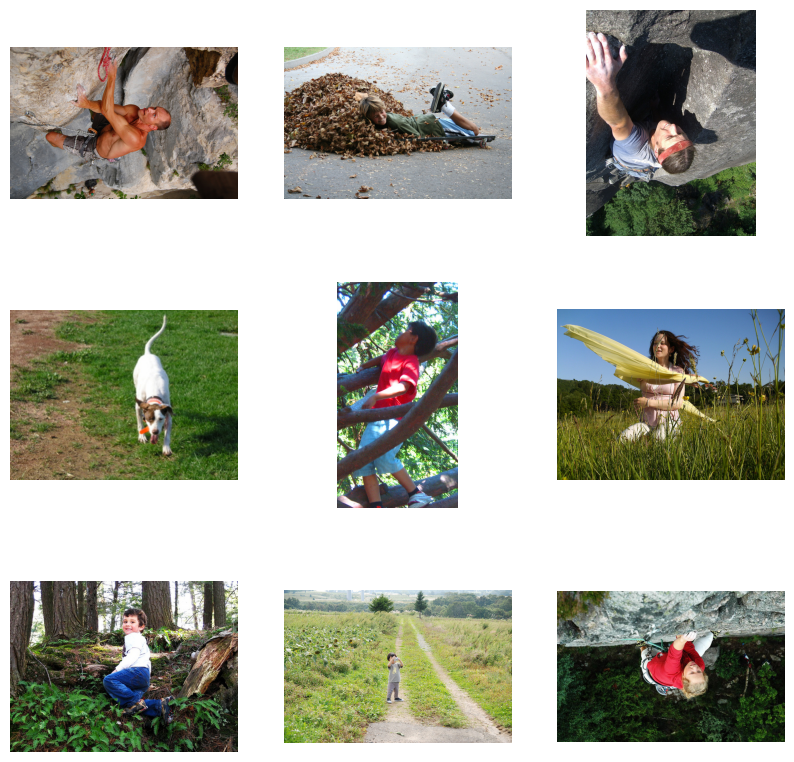

Matched image: 2540360421_f7c2401da8.jpg
Matched image: 3508522093_51f6d77f45.jpg
Matched image: 209605542_ca9cc52e7b.jpg
Matched image: 3103264875_2a8d534abc.jpg
Matched image: 2846037553_1a1de50709.jpg
Matched image: 2909875716_25c8652614.jpg
Matched image: 2424111022_4e332b8aee.jpg
Matched image: 1386964743_9e80d96b05.jpg
Matched image: 210839948_bbd5bfa3b6.jpg

Total time taken for 46 queries: 62.02 seconds


In [41]:
# Run the test
test_multiple_queries_with_faiss(
    model=model,
    image_embeddings=image_embeddings,
    image_filenames=valid_df['image'].values,
    queries=queries,
    n=9
)